In [1]:
import sys
sys.path.insert(1, '../..')

import convml_tt
from utils import *

from convml_tt.system import TripletTrainerModel, TripletTrainerDataModule
from convml_tt.data.examples import fetch_example_dataset, ExampleData, fetch_pretrained_model, PretrainedModel
from convml_tt.data.dataset import TileType, ImageSingletDataset
from convml_tt.utils import get_embeddings
import convml_tt.interpretation
import cv2
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib.patches import Polygon
from matplotlib.collections import PatchCollection

import xarray as xr
import pandas as pd
import pytorch_lightning as pl
from matplotlib.patches import Polygon
from matplotlib.collections import PatchCollection
import torch
from sklearn.decomposition import PCA
from PIL import Image
import os, shutil
from matplotlib.patches import Rectangle as rectan
from random import seed
from random import randint
from sklearn.metrics import confusion_matrix
from PIL import Image
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
#from sklearn.neighbors.nearest_centroid import NearestCentroid

from convml_tt.interpretation.rectpred.transform import apply_transform
from convml_tt.data.examples import load_pretrained_model, PretrainedModel
from convml_tt.interpretation.rectpred.data import make_sliding_tile_model_predictions
from convml_tt.interpretation.rectpred.plot import make_rgb
from tqdm.notebook import tqdm
import numpy as np
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

TEST_SIZE = 0.3
RANDOM_STATE = 1024
COLORS = ['b', 'g', 'r', 'm'] # Color of each class

DATASET_DIR = "../../../DATASETS/zooniverse_kaggle/"
print(cv2.__version__)
TILE_FILENAME_FORMAT = "{triplet_id:05d}_{tile_type}.png"
TEST_SIZE = 0.3
RANDOM_STATE = 1024
COLORS = ['b', 'g', 'r', 'm'] # Color of each class
DATASETS_path = "../../../DATASETS/"
print(cv2.__version__)
print(np.__version__)
pca = PCA(n_components=3, svd_solver='arpack')



4.5.2
4.5.2
4.5.2
1.20.0


In [2]:
model = TripletTrainerModel.load_from_checkpoint(checkpoint_path="c:/Users/Ray/Documents/Stage/MODELS/zooniverse-model.ckpt")
df = pd.read_csv("../../../DATASETS/zooniverse_kaggle/train.csv")

In [4]:
df['Image'] = df['Image_Label'].map(lambda x: x.split('_')[0])
df['Class'] = df['Image_Label'].map(lambda x: x.split('_')[1])
classes = df['Class'].unique()
train_df = df.groupby('Image')['Class'].agg(set).reset_index()
for class_name in classes:
    df[class_name] = df['Class'].map(lambda x: 1 if class_name in x else 0)
df.head()

# Creating training samples

image_col = np.array(df['Image'])
image_files = image_col[::4]
all_labels = df['Class']
X_train, y_train = image_files, all_labels
train_pairs = np.array(list(zip(X_train, y_train)))
TILE_FILENAME_FORMAT = "{triplet_id:05d}_{tile_type}.png"
NUM_TRAIN_SAMPLES = len(train_pairs)
train_samples = train_pairs[np.random.choice(train_pairs.shape[0], NUM_TRAIN_SAMPLES, replace=False), :]

  0%|                                                                                           | 0/14 [00:00<?, ?it/s]

DIV : 612
DATASET : ../../../DATASETS/MULTI_SCALE/612/


C:\Users\Ray\anaconda3\lib\site-packages\torch\nn\functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  ..\c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:28<00:00,  2.03s/it]


424


ValueError: Found input variables with inconsistent numbers of samples: [0, 424]

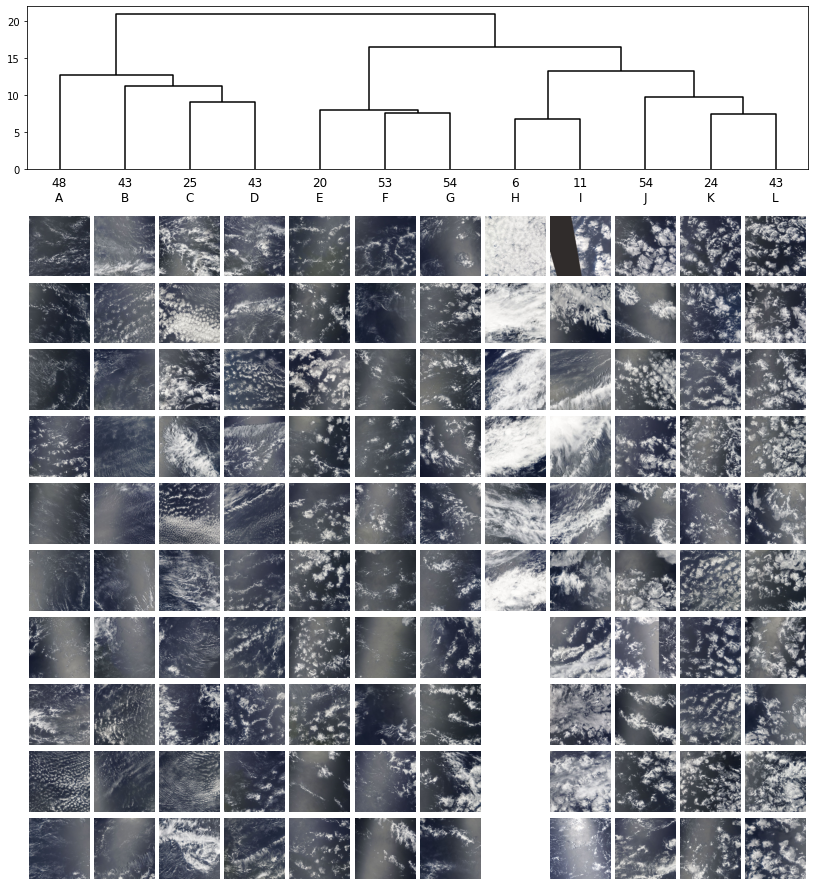

In [9]:
import os
from sklearn.metrics.cluster import normalized_mutual_info_score
import glob
import shutil
from pathlib import Path
import pathlib
import json
from IPython.display import clear_output

divisions = [64, 128, 256, 512, 1024, 256, 850, 612] # # #range(16, 224, 16) # 
shown = False
goal_per_class = 100

f = open('normalized_mutual_info_scores.json', 'r')
nmis = json.load(f)
for div in reversed(divisions):
    print("DIV : "+str(div))
    labs = []
    shown = True
    t = 0
    associations = ['Fish', 'Flower', 'Gravel', 'Sugar']
    PATH_TRAIN = DATASETS_path+'MULTI_SCALE/'+str(div)+"/train/"
    dataset_path =  DATASETS_path+'MULTI_SCALE/'+str(div)+'/'
    """
    if not Path(PATH_TRAIN).is_dir():
        p = pathlib.Path(PATH_TRAIN)
        p.mkdir(parents=True, exist_ok=True)
    
    stats = {}
    
    classes = {}
    classes['0'] = 0
    classes['1'] = 0
    classes['2'] = 0
    classes['3'] = 0
    os.mkdir(DATASETS_path+'MULTI_SCALE/'+str(div))
    os.mkdir(PATH_TRAIN)
    for sample in tqdm(train_samples):
            
            clear_output(wait=True)
            print("DIV  = "+str(div))
            print("T = "+str(t))
            
            img_path = os.path.join(DATASET_DIR, 'train_images', sample[0])
            img = cv2.imread(img_path, 1)
            labels = df[df['Image_Label'].str.contains(sample[0])]['EncodedPixels']
            for idx, rle in enumerate(labels.values):
                if rle is not np.nan and classes[str(idx)]<=goal_per_class:
                    mask = rle2mask(rle)
                    contours, _ = cv2.findContours(mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
                    rgbImg = extract_contour(img, contours, shown=shown, direct=True)
                    for x in range(0, rgbImg.shape[0], div):
                        for y in range(0, rgbImg.shape[1], div):
                            if rgbImg[x:x+div,y:y+div].shape != (div, div, 3) or [0,0,0] in rgbImg[x:x+div,y:y+div]:
                                continue
                            tm = t
                            grgr = cv2.resize(rgbImg[x:x+div,y:y+div], (256, 256), interpolation = cv2.INTER_AREA)
                            out_name = TILE_FILENAME_FORMAT.format(triplet_id=tm,tile_type='anchor')
                            out_name = PATH_TRAIN+out_name
                            cv2.imwrite(out_name, grgr)
                            t += 1
                            labs.append(idx)
                            
                            classes[str(idx)] += 1
                            
            test = True
            
            for key in classes:
                if classes[key] <= goal_per_class:
                    test = False
            
            test = t == 25000
            if t>25000:
                break

    
    classes = {}
    classes['0'] = []
    classes['1'] = []
    classes['2'] = []
    classes['3'] = []
    cnt = 0

    for i in labs:
        classes[str(i)].append(cnt)
        cnt += 1
    guards = []
    compare_to = []
    for key in classes:
        print(str(key)+" len of "+str(len(classes[key]))+" scale "+str(div))
        guards += classes[key][:30]
        for index in classes[key][:30]:
            compare_to.append(labs[index])
    guards_names = []
    for j in guards:
        out_name = TILE_FILENAME_FORMAT.format(triplet_id=j, tile_type='anchor')
        #out_name = DATASETS_path+"MULTI_SCALE/"+str(div)+"/train/"+out_name
        guards_names.append(out_name)
    
    for filepath in glob.iglob(DATASETS_path+"MULTI_SCALE/"+str(div)+"/train/*"):
        ls = filepath.split("\\")[-1]
        if ls not in guards_names:
            os.remove(filepath)
    """
    print("DATASET : "+str(dataset_path))
    
    
    tile_dataset = ImageSingletDataset(data_dir=dataset_path, tile_type=TileType.ANCHOR)
    da_embeddings = get_embeddings(tile_dataset=tile_dataset,
     model=model)
    clusters = convml_tt.interpretation.plots.dendrogram(da_embeddings, n_samples=10, n_clusters_max=12, return_clusters=True, label_clusters=True)

    print(len(clusters[1]))
    nmi = normalized_mutual_info_score(labs, clusters[1])
    print(str(div)+" scale have NMI = "+str(nmi))
    nmis[str(div)] = nmi
    
    shutil.rmtree(DATASETS_path+'MULTI_SCALE/'+str(div)+"/train", ignore_errors=True)
    shutil.rmtree(DATASETS_path+'MULTI_SCALE/'+str(div), ignore_errors=True)
    with open('normalized_mutual_info_scores.json', 'w') as fp:
        json.dump(nmis, fp)
        
    x = list(nmis.keys())
    y = list(nmis.values())
    plt.figure()
    plt.plot(x, y)
    plt.title('Plot of NMI evolution')
    plt.ylabel('NMI')
    plt.xlabel('Scale in pixels')
    plt.show()
    
    
    clclc = list(map(int, clusters[1]))
    cfs_mat = confusion_matrix(labs, clclc)

    associations = ['Fish', 'Flower', 'Gravel', 'Sugar']
    fig, ax = plt.subplots(figsize=(20,10)) 
    plt.title("Confusion Matrix Clusters MODIS model SCALE "+str(div))
    sns.set(font_scale=1.8)
    sns.heatmap(cfs_mat[:4,:], annot=True, fmt='', ax=ax, linewidths=.9, yticklabels=associations)
    fig, ax = plt.subplots(figsize=(20,10))
    print(cfs_mat[:4,:].shape)
    print(   np.sum(  cfs_mat[:4,:], axis=1  ).shape  )
    print(   (  cfs_mat[:4,:].T/np.sum(cfs_mat[:4,:], axis=1)    ).shape  )
    plt.title("Confusion Matrix Clusters MODIS model %  SCALE "+str(div))
    sns.heatmap( (cfs_mat[:4,:].T/np.sum(cfs_mat[:4,:], axis=1)).T, annot=True, 
                fmt='.2%', cmap='Blues' , yticklabels=associations)
    print(len(da_embeddings))
    
    
    pca_2d = PCA(n_components=2, svd_solver='arpack')
    principalComponents = pca_2d.fit_transform(da_embeddings)
    print(principalComponents.shape)
    print(principalComponents[:, 0].shape)
    print(principalComponents[:, 0])
    print("\n\n\n")
    from sklearn.model_selection import train_test_split
    X_train, X_test, y_train, y_test = train_test_split( principalComponents, clusters[1], test_size=0.01, random_state=42)

    fig, ax = plt.subplots(figsize=(15,15))

    ax.scatter(principalComponents[:, 0], principalComponents[:, 1], c=clusters[1], s=1)
    plt.title('Scatter plot of images embedding depending PC SCALE'+str(div))
    ax.set_xlabel('PC 1')
    ax.set_ylabel('PC 2')
    
    for cluster_number in range(0, 12):
        indices = np.where(clusters[1]==cluster_number)[0]
        idx = np.random.choice(indices)
        tm = TILE_FILENAME_FORMAT.format(triplet_id=idx,tile_type='anchor')
        filename = DATASETS_path+"MULTI_SCALE/"+str(div)+"/train/"+tm
        print("filename : "+str(filename))
        arr_img = plt.imread(filename, format='png')    
        imagebox = OffsetImage(arr_img, zoom=0.2)
        xy = (principalComponents[idx, 0], principalComponents[idx, 1])
        
        ab = AnnotationBbox(imagebox, xy,
            xybox=(30, -30),
            xycoords='data',
            boxcoords="offset points")
        ax.add_artist(ab)


    plt.show()

    print(X_test[:, 0].shape)
    print(X_test[:, 0])
    print("\n\n\n")
    fig, ax = plt.subplots(figsize=(15,15))
    ax.scatter(X_test[:, 0], X_test[:, 1], c=y_test, s=20)
    plt.title('Scatter plot of a sample of images embedding depending PC SCALE '+str(div))
    ax.set_xlabel('PC 1')
    ax.set_ylabel('PC 2')
    plt.show()

In [ ]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

print("NMI")
print(nmis)
print("\n\n")
x = list(nmis.keys())
y = list(nmis.values())
print("x : "+str(x))
print("y : "+str(y))
data_preproc = pd.DataFrame({
    "scale":x, "nmi":y,
})
fig, ax = plt.subplots(figsize=(15, 15))
sns.lineplot(x="scale", y="nmi", data=data_preproc)

DATASET : ../../../DATASETS/MULTI_SCALE/256/
['labels.pickle', 'train']
100%|██████████| 640/640 [22:11<00:00,  2.08s/it]
20463
20463
(4, 12)
(4,)
(12, 4)
20463
(20463, 2)
(20463,)
[ 1.1285174   0.17598367  0.9627166  ... -0.8985701  -0.92118984
 -1.2660785 ]






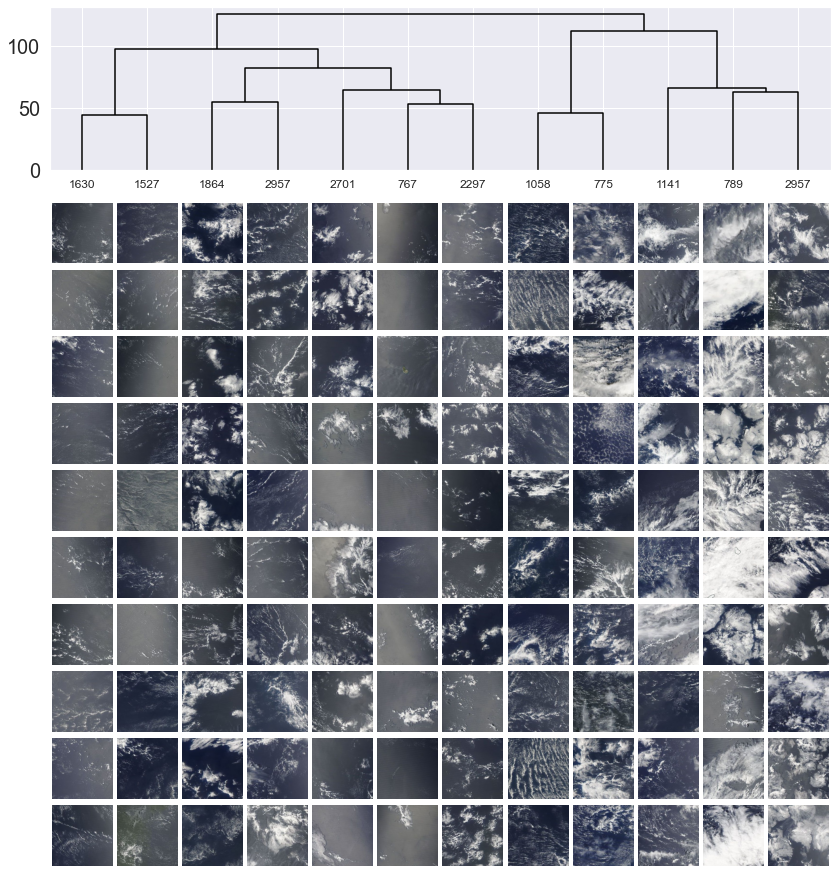

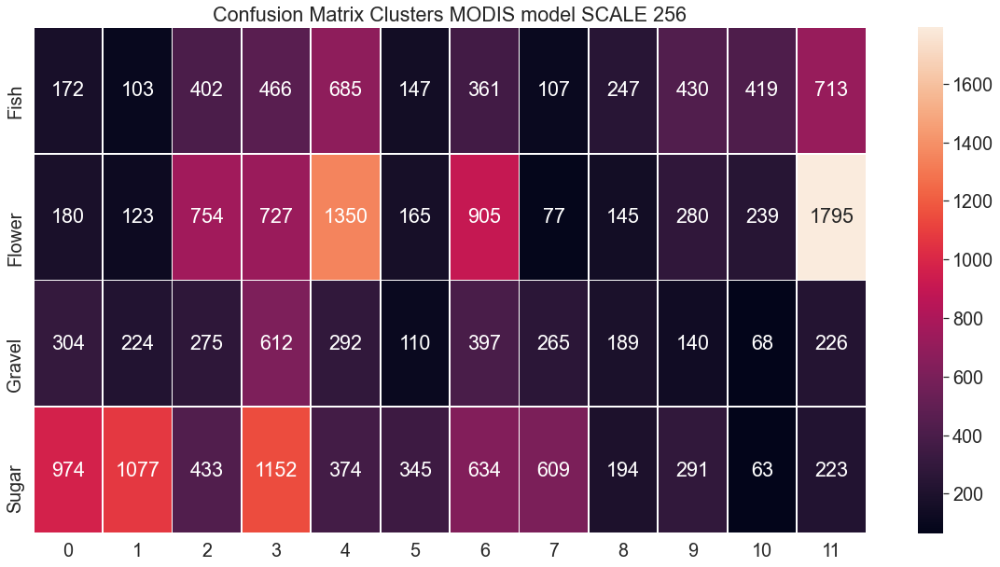

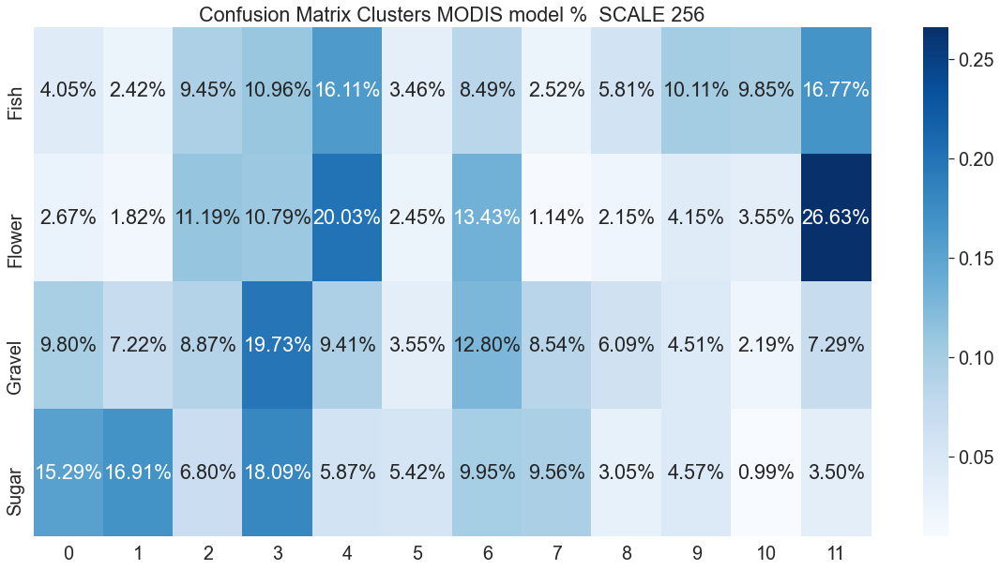

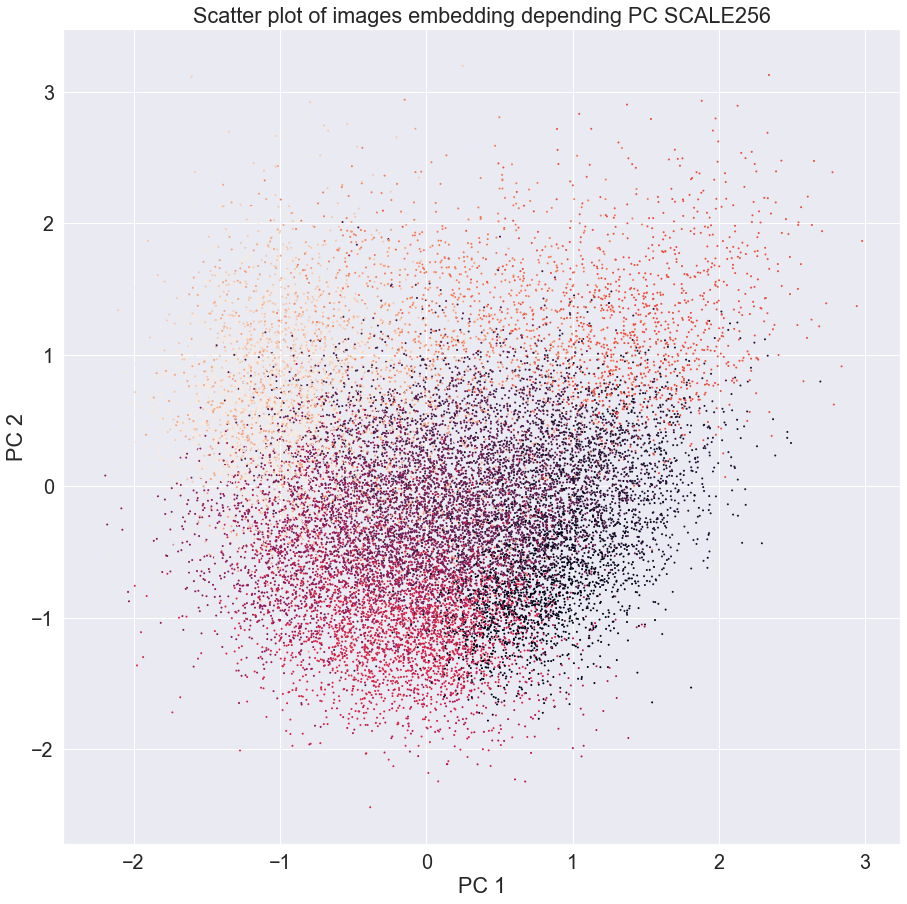

(205,)
[-3.42862487e-01  6.46894932e-01 -1.22683990e+00  6.28046632e-01
 -6.09394209e-03 -1.58925736e+00 -1.67460012e+00  2.47389719e-01
  8.19901451e-02  7.35468447e-01  1.76845372e-01  4.27061826e-01
  5.59731841e-01  2.22771227e-01 -5.12941241e-01 -6.89883649e-01
 -9.12646770e-01  4.92471695e-01 -1.10526824e+00 -1.84461236e+00
  2.33075202e-01 -4.89883423e-01 -1.19555734e-01 -1.44297814e+00
  6.68689728e-01 -3.44156265e-01 -2.48775885e-01  3.51674736e-01
  1.06356561e-01 -3.05174403e-02  1.24305165e+00 -3.42874348e-01
 -4.24896568e-01 -1.66312289e+00 -3.75733942e-01  1.41825604e+00
  6.24730349e-01 -1.19542360e+00 -1.66180980e+00  1.34383714e+00
  1.84855735e+00  7.45903194e-01  5.25542974e-01  1.32158852e+00
  3.03938657e-01  1.32839286e+00  1.96624532e-01 -1.31361735e+00
  4.79884624e-01 -8.61447632e-01 -7.14752614e-01 -1.31649315e+00
 -9.10872221e-01  9.83067572e-01 -4.74849641e-01  9.12332952e-01
 -1.59384519e-01  8.71855736e-01 -5.55440605e-01 -4.91044164e-01
 -1.01612520e+00  

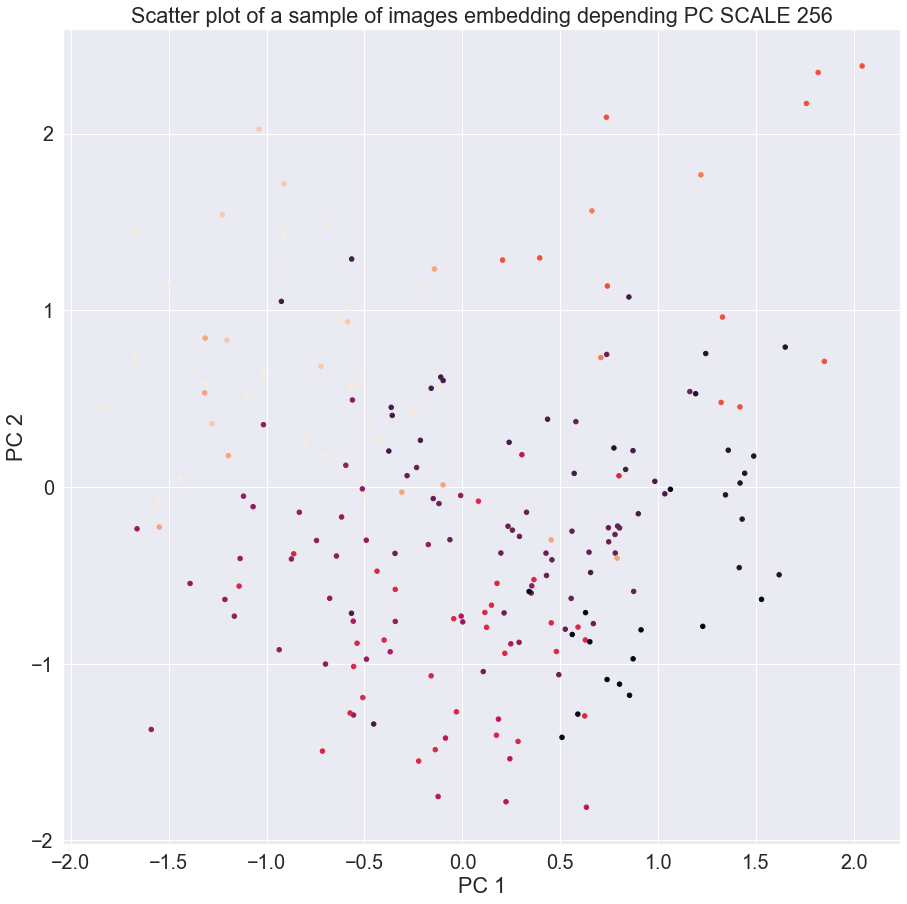

In [6]:
div = 256
dataset_path =  DATASETS_path+'MULTI_SCALE/'+str(div)+'/'
print("DATASET : "+str(dataset_path))
print(os.listdir(dataset_path))
tile_dataset = ImageSingletDataset(data_dir=dataset_path, tile_type=TileType.ANCHOR)
da_embeddings = get_embeddings(tile_dataset=tile_dataset, model=model)
clusters = convml_tt.interpretation.plots.dendrogram(da_embeddings, n_samples=10, n_clusters_max=12, return_clusters=True)#, label_clusters=True)
with open(DATASETS_path+"MULTI_SCALE/"+str(div)+"/labels.pickle", "rb") as handle:
    labs = pickle.load(handle)
try:
    labs = labs[:25001]
except:
    labs = labs
print(len(labs))
print(len(clusters[1]))
clclc = list(map(int, clusters[1]))
cfs_mat = confusion_matrix(labs, clclc)

associations = ['Fish', 'Flower', 'Gravel', 'Sugar']

pca_2d = PCA(n_components=2, svd_solver='arpack')
principalComponents = pca_2d.fit_transform(da_embeddings)
print(principalComponents.shape)
print(principalComponents[:, 0].shape)
print(principalComponents[:, 0])
print("\n\n\n")
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split( principalComponents, clusters[1], test_size=0.01, random_state=42)








In [11]:
print(len(labs))
print(np.unique(clusters[1]))
print(np.where(clusters[1]==3)[0])

20463
[ 0  1  2  3  4  5  6  7  8  9 10 11]
[    1     3    11 ... 20450 20451 20453]


(4, 12)
(4,)
(12, 4)
20463
filename : ../../../DATASETS/MULTI_SCALE/256/train/18783_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/09743_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/13173_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/12408_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/05245_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/18045_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/00953_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/15450_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/17789_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/09817_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/01821_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/04723_anchor.png


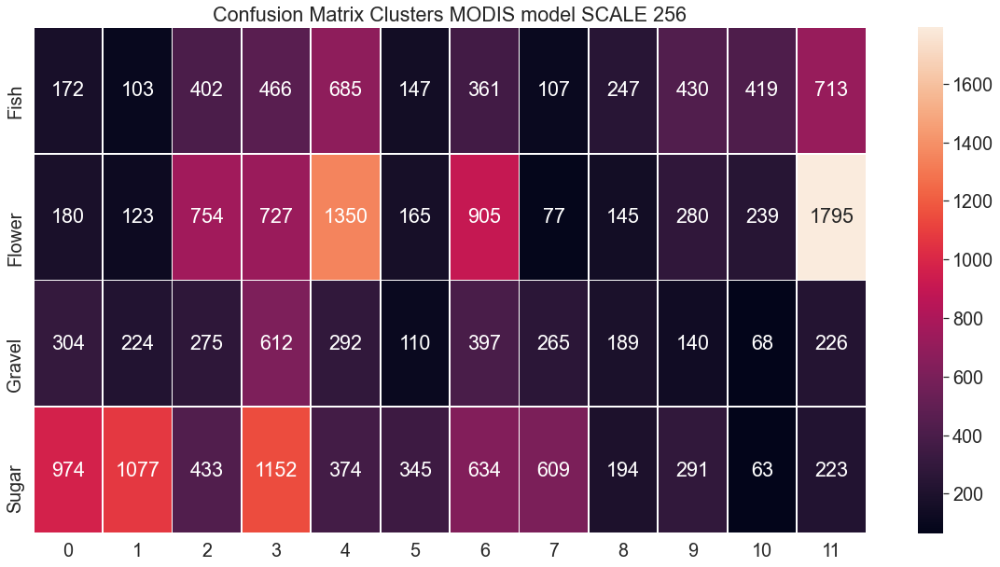

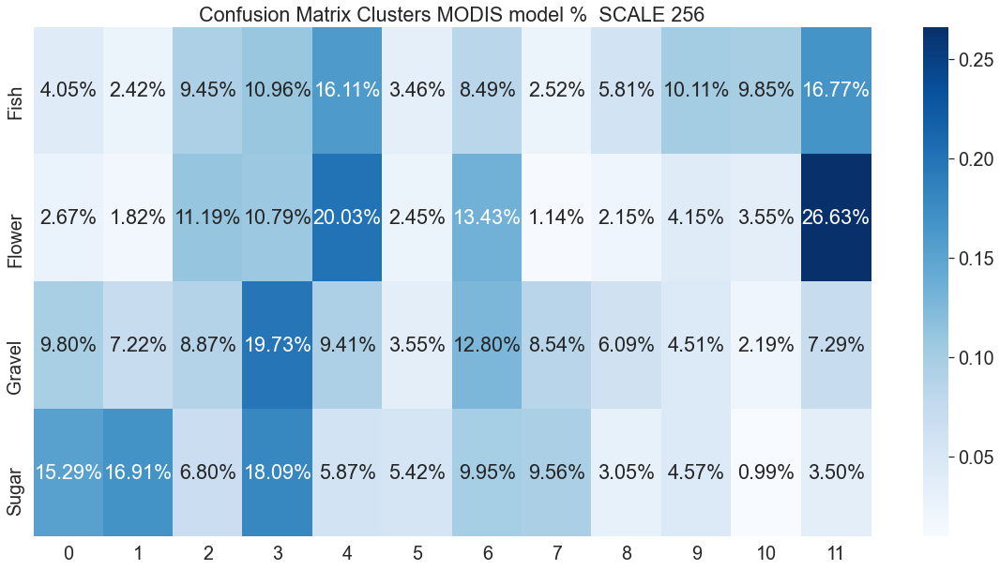

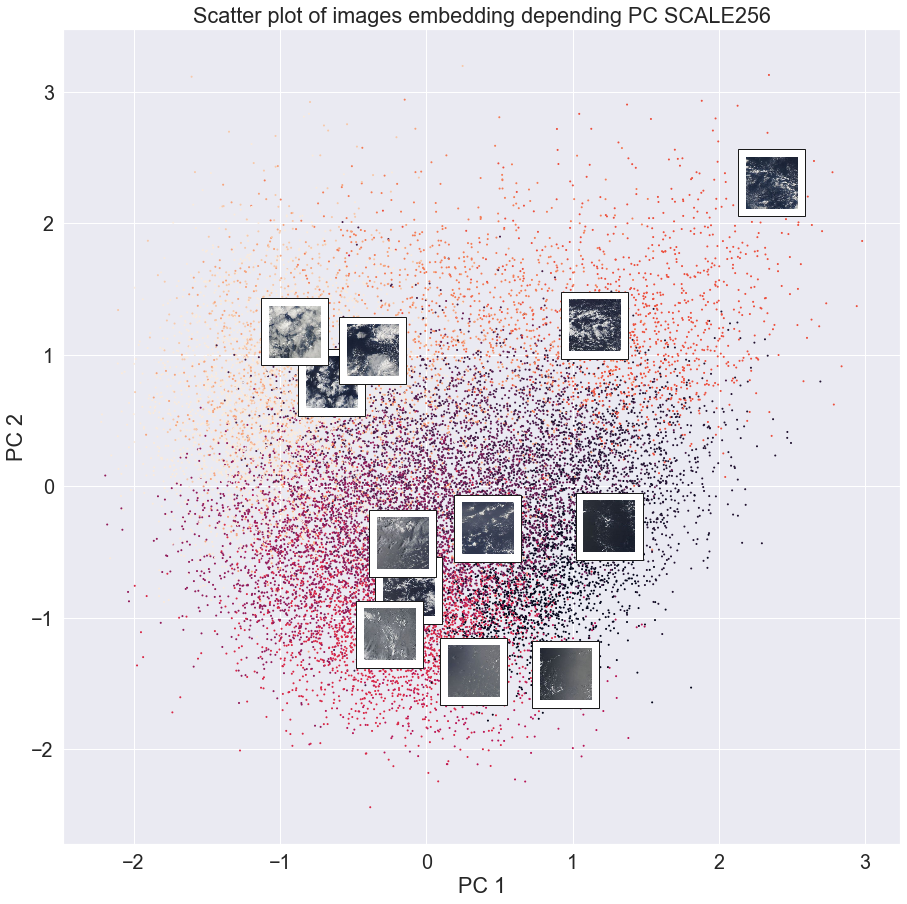

(205,)
[-3.42862487e-01  6.46894932e-01 -1.22683990e+00  6.28046632e-01
 -6.09394209e-03 -1.58925736e+00 -1.67460012e+00  2.47389719e-01
  8.19901451e-02  7.35468447e-01  1.76845372e-01  4.27061826e-01
  5.59731841e-01  2.22771227e-01 -5.12941241e-01 -6.89883649e-01
 -9.12646770e-01  4.92471695e-01 -1.10526824e+00 -1.84461236e+00
  2.33075202e-01 -4.89883423e-01 -1.19555734e-01 -1.44297814e+00
  6.68689728e-01 -3.44156265e-01 -2.48775885e-01  3.51674736e-01
  1.06356561e-01 -3.05174403e-02  1.24305165e+00 -3.42874348e-01
 -4.24896568e-01 -1.66312289e+00 -3.75733942e-01  1.41825604e+00
  6.24730349e-01 -1.19542360e+00 -1.66180980e+00  1.34383714e+00
  1.84855735e+00  7.45903194e-01  5.25542974e-01  1.32158852e+00
  3.03938657e-01  1.32839286e+00  1.96624532e-01 -1.31361735e+00
  4.79884624e-01 -8.61447632e-01 -7.14752614e-01 -1.31649315e+00
 -9.10872221e-01  9.83067572e-01 -4.74849641e-01  9.12332952e-01
 -1.59384519e-01  8.71855736e-01 -5.55440605e-01 -4.91044164e-01
 -1.01612520e+00  

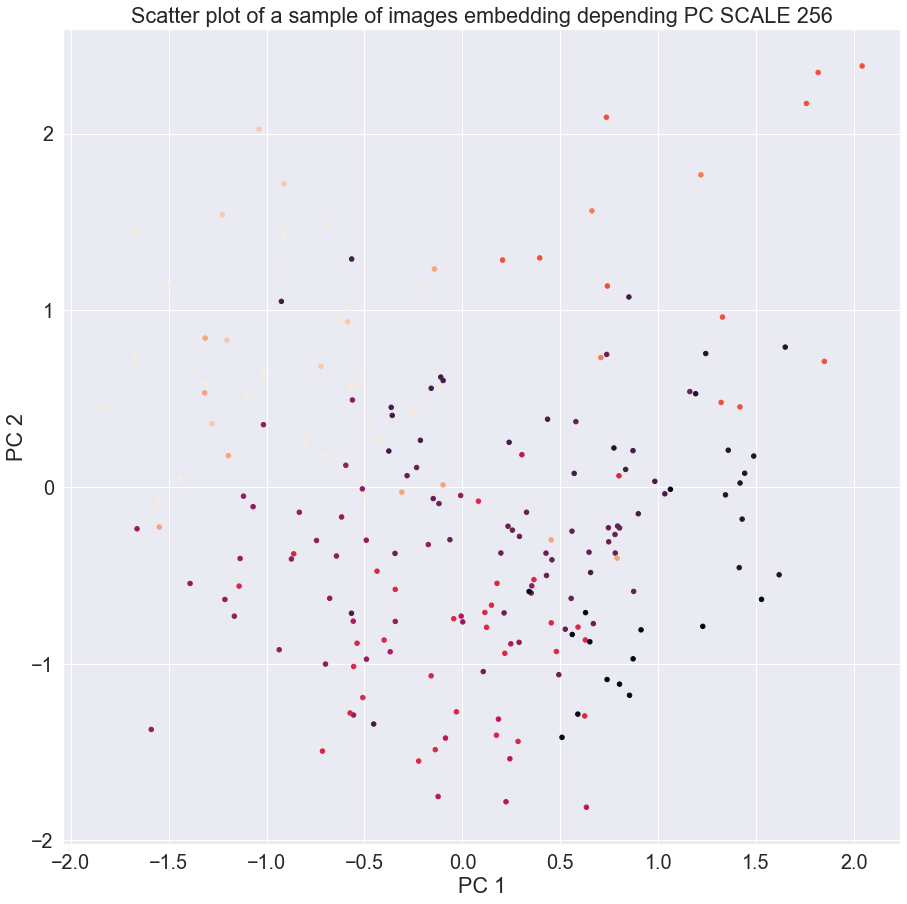

In [18]:
from matplotlib.cbook import get_sample_data

fig, ax = plt.subplots(figsize=(20,10)) 
plt.title("Confusion Matrix Clusters MODIS model SCALE "+str(div))
sns.set(font_scale=1.8)
sns.heatmap(cfs_mat[:4,:], annot=True, fmt='', ax=ax, linewidths=.9, yticklabels=associations)
fig, ax = plt.subplots(figsize=(20,10))
print(cfs_mat[:4,:].shape)
print(   np.sum(  cfs_mat[:4,:], axis=1  ).shape  )
print(   (  cfs_mat[:4,:].T/np.sum(cfs_mat[:4,:], axis=1)    ).shape  )
plt.title("Confusion Matrix Clusters MODIS model %  SCALE "+str(div))
sns.heatmap( (cfs_mat[:4,:].T/np.sum(cfs_mat[:4,:], axis=1)).T, annot=True, 
            fmt='.2%', cmap='Blues' , yticklabels=associations)
print(len(da_embeddings))

TILE_FILENAME_FORMAT = "{triplet_id:05d}_{tile_type}.png"


fig, ax = plt.subplots(figsize=(15,15))

ax.scatter(principalComponents[:, 0], principalComponents[:, 1], c=clusters[1], s=1)
plt.title('Scatter plot of images embedding depending PC SCALE'+str(div))
ax.set_xlabel('PC 1')
ax.set_ylabel('PC 2')



for cluster_number in range(0, 12):
    indices = np.where(clusters[1]==cluster_number)[0]
    idx = np.random.choice(indices)
    tm = TILE_FILENAME_FORMAT.format(triplet_id=idx,tile_type='anchor')
    filename = DATASETS_path+"MULTI_SCALE/"+str(div)+"/train/"+tm
    print("filename : "+str(filename))
    arr_img = plt.imread(filename, format='png')    
    imagebox = OffsetImage(arr_img, zoom=0.2)
    xy = (principalComponents[idx, 0], principalComponents[idx, 1])
    
    ab = AnnotationBbox(imagebox, xy,
        xybox=(30, -30),
        xycoords='data',
        boxcoords="offset points")
    ax.add_artist(ab)

plt.show()














print(X_test[:, 0].shape)
print(X_test[:, 0])
print("\n\n\n")
fig, ax = plt.subplots(figsize=(15,15))
ax.scatter(X_test[:, 0], X_test[:, 1], c=y_test, s=20)
plt.title('Scatter plot of a sample of images embedding depending PC SCALE '+str(div))
ax.set_xlabel('PC 1')
ax.set_ylabel('PC 2')
plt.show()

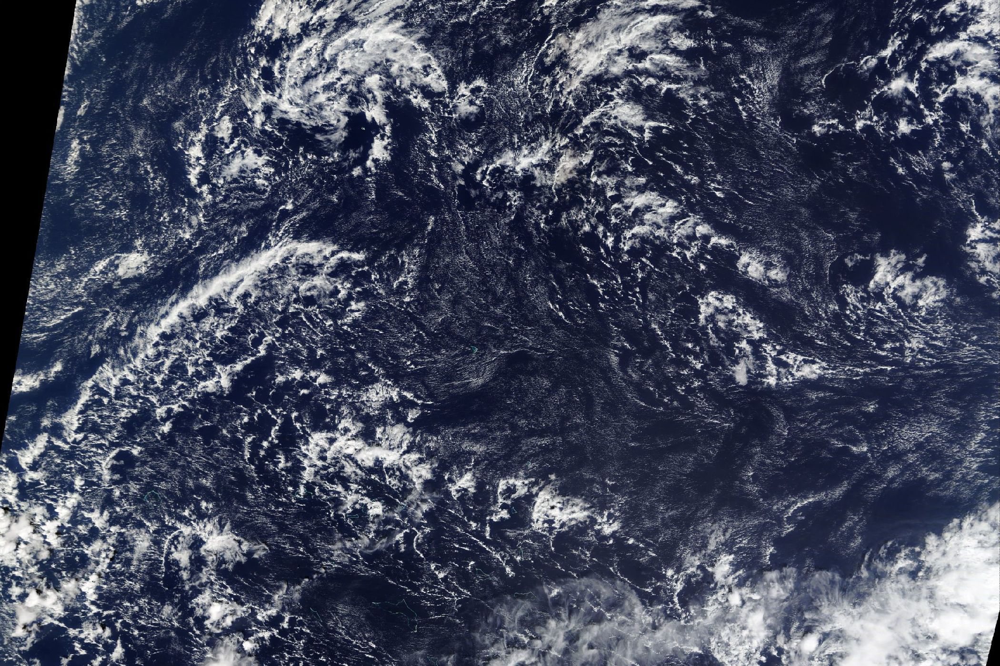

In [9]:
img = Image.open(DATASETS_path+"zooniverse_kaggle/train_images/2d9da73.jpg")
img

In [10]:
da_emb = make_sliding_tile_model_predictions(img=img, model=model, step=(100, 100))

100%|██████████| 8/8 [00:21<00:00,  2.66s/it]


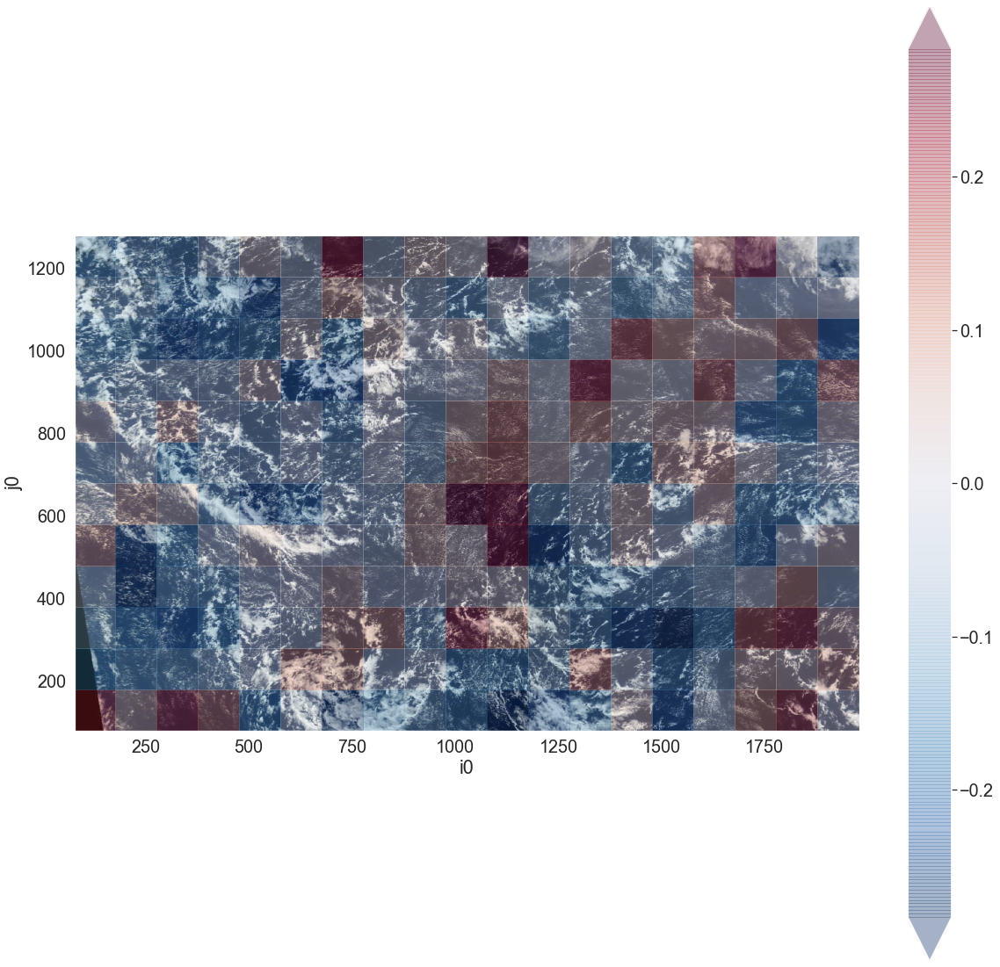

In [11]:
r_aspect = img.size[0] / img.size[1] * 1.4
fig, ax = plt.subplots(figsize=(20, 20))
ax.imshow(img)
da_emb.isel(emb_dim=0).plot(ax=ax, y="j0", alpha=0.3, robust=True)

C:\Users\Ray\anaconda3\lib\site-packages\xarray\core\dataarray.py:745: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return key in self.data


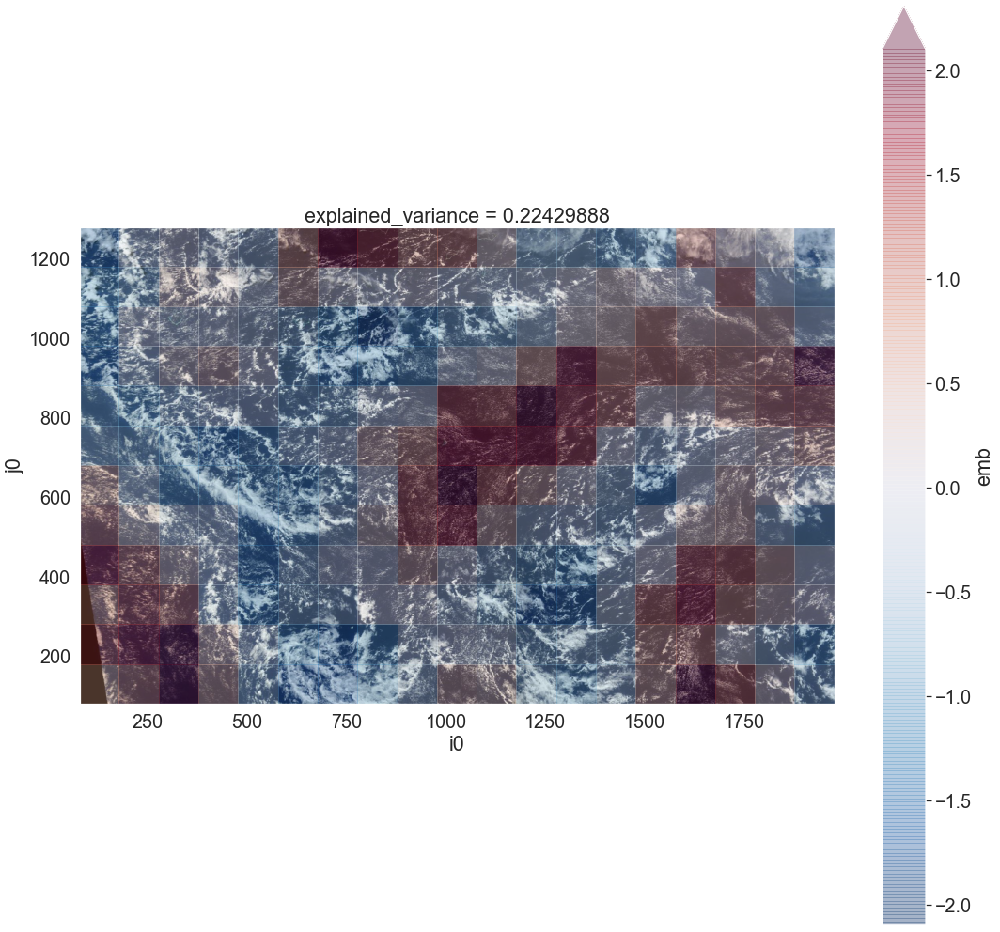

In [12]:
da_emb_pca = apply_transform(da_emb, "pca")

r_aspect = img.size[0] / img.size[1] * 1.4
fig, ax = plt.subplots(figsize=(18,18))
ax.imshow(img)
da_emb_pca.isel(pca_dim=0).plot(ax=ax, y="j0", alpha=0.3, robust=True)

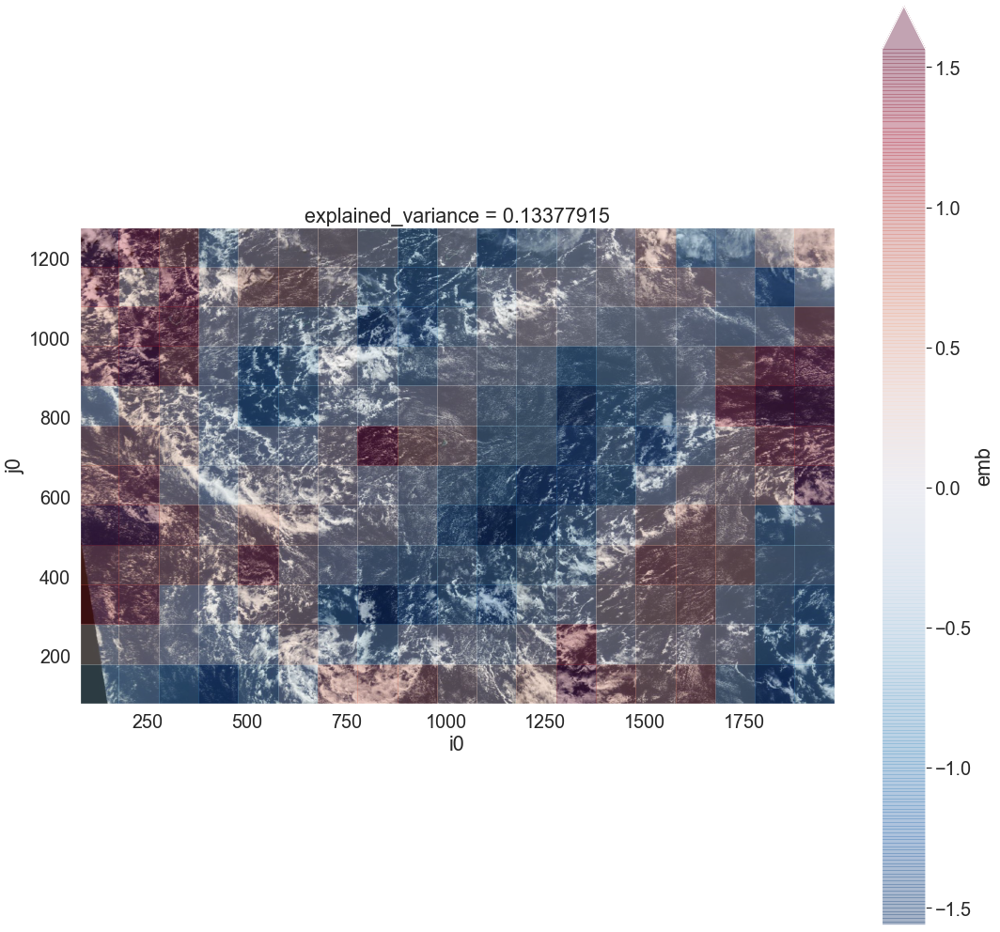

In [13]:
# looking at the second PCA component

r_aspect = img.size[0] / img.size[1] * 1.4
fig, ax = plt.subplots(figsize=(18,18))
ax.imshow(img)
da_emb_pca.isel(pca_dim=1).plot(ax=ax, y="j0", alpha=0.3, robust=True)

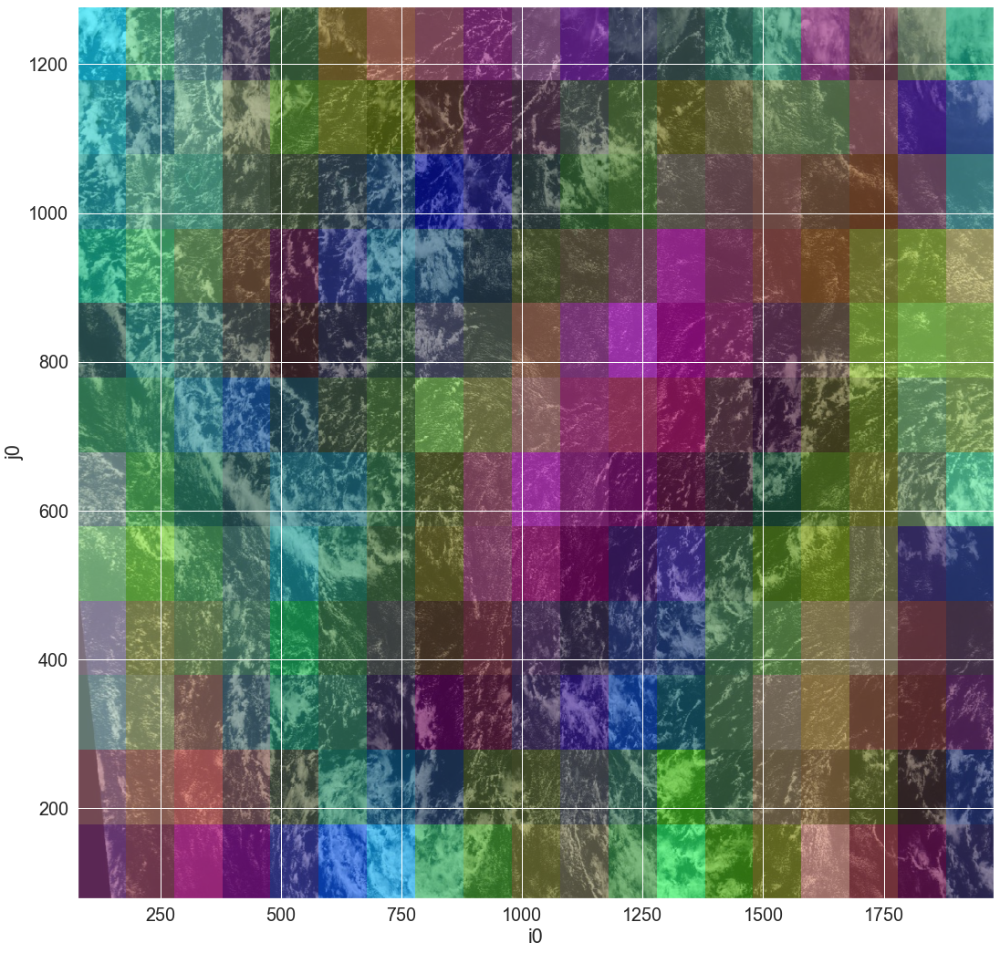

In [14]:
da_rgba = make_rgb(da_emb_pca, pca_dim=[0,1,2], alpha=0.6)
r_aspect = img.size[0] / img.size[1]
fig, ax = plt.subplots(figsize=(18 ,18))
ax.imshow(img)
da_rgba.plot.imshow(rgb="rgba", y="j0", ax=ax)

(11836,)
[ 1.5361351  -0.44999328 -0.5005568  ... -0.00219912 -0.72473
 -0.69019413]






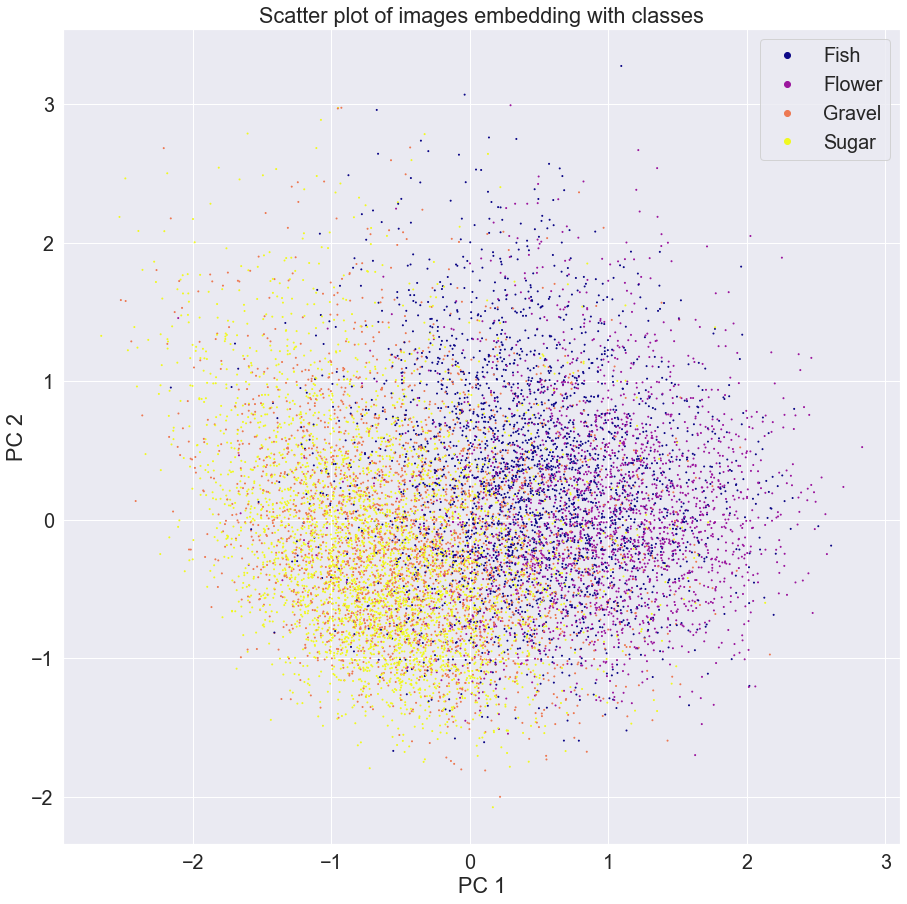

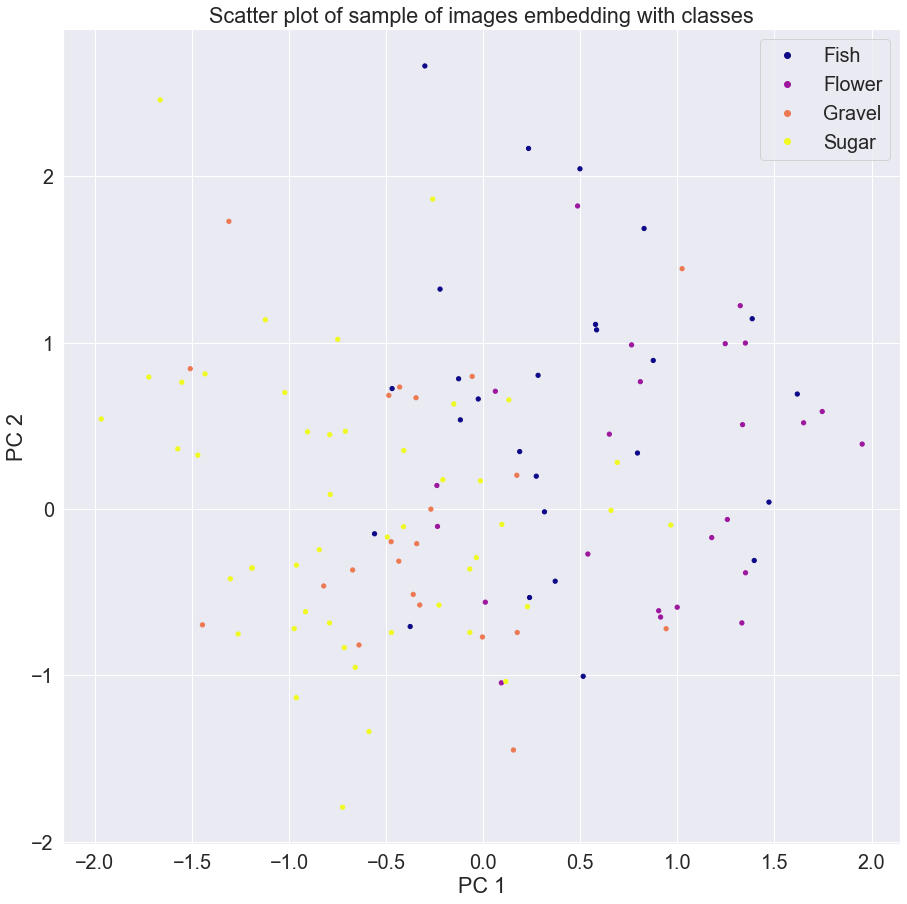

Centroids : 
[[ 0.44224703  0.29699537]
 [ 0.95678753  0.08077163]
 [-0.38758159 -0.10442509]
 [-0.62745595 -0.18929985]]
Shape : (4, 2)


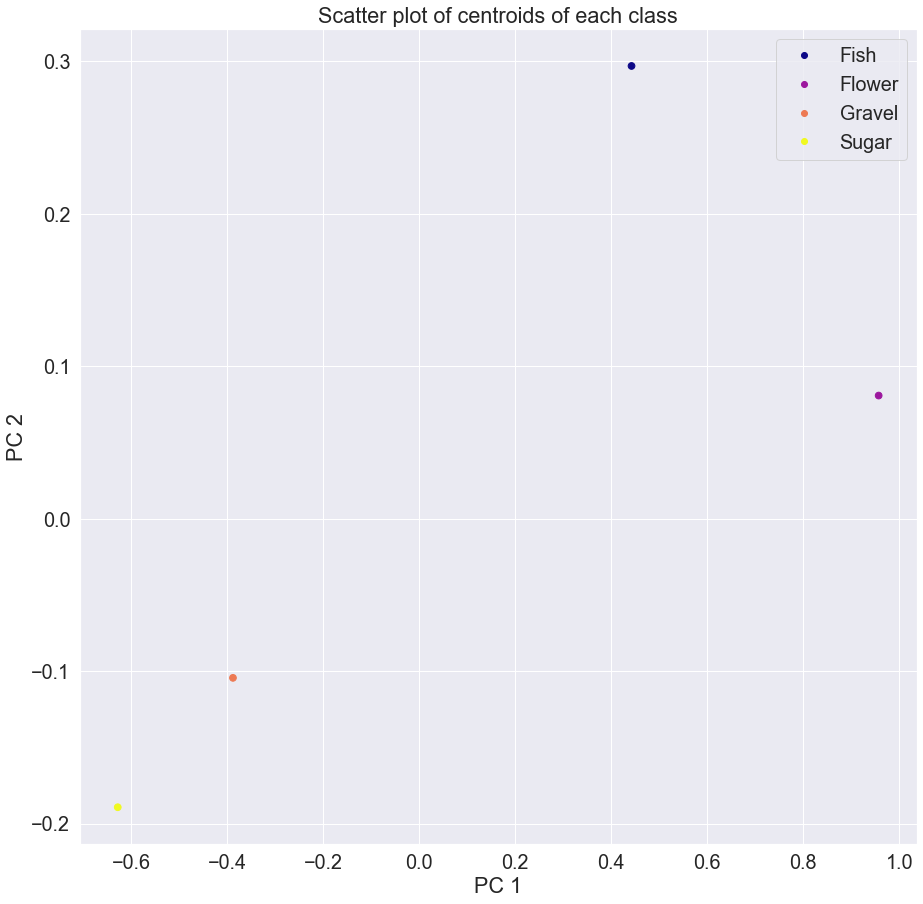

In [15]:
print(principalComponents[:, 0].shape)
print(principalComponents[:, 0])
print("\n\n\n")

labs_np = np.array(labs)
X_train, X_test, y_train, y_test = train_test_split( principalComponents, labs, test_size=0.01, random_state=42)




fig, ax = plt.subplots(figsize=(15,15))

scatter = ax.scatter(principalComponents[:, 0], principalComponents[:, 1], c=labs, s=1 , cmap="plasma")
plt.legend(handles=scatter.legend_elements()[0], labels=associations)
plt.title('Scatter plot of images embedding with classes')
ax.set_xlabel('PC 1')
ax.set_ylabel('PC 2')
plt.show()



fig, ax = plt.subplots(figsize=(15,15))

scatter = ax.scatter(X_test[:, 0], X_test[:, 1], c=y_test, s=18 , cmap="plasma")
plt.legend(handles=scatter.legend_elements()[0], labels=associations)
plt.title('Scatter plot of sample of images embedding with classes')
ax.set_xlabel('PC 1')
ax.set_ylabel('PC 2')
plt.show()





clf = NearestCentroid()
clf.fit(principalComponents, labs)
fig, ax = plt.subplots(figsize=(15,15))
print("Centroids : ")
print(clf.centroids_)
print("Shape : "+str(clf.centroids_.shape))
scatter = ax.scatter(clf.centroids_[:, 0], clf.centroids_[:, 1], c=[0, 1, 2, 3], s=45 , cmap="plasma")
plt.legend(handles=scatter.legend_elements()[0], labels=associations)
plt.title('Scatter plot of centroids of each class')
ax.set_xlabel('PC 1')
ax.set_ylabel('PC 2')
plt.show()



DATASET : ../../../DATASETS/MULTI_SCALE/64/
['labels.pickle', 'train']


100%|████████████████████████████████████████████████████████████████████████████████| 313/313 [09:36<00:00,  1.84s/it]


10000
10000
(4, 12)
(4,)
(12, 4)
10000
10000
64 scale have NMI = 0.00590539424538167
(10000, 2)
(10000,)
[ 2.0781603   1.7953793   1.8914659  ... -1.6264908  -1.2211157
  0.77603596]




filename : ../../../DATASETS/MULTI_SCALE/64/train/02265_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/64/train/03804_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/64/train/03016_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/64/train/04305_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/64/train/06633_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/64/train/08270_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/64/train/04595_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/64/train/08204_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/64/train/07877_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/64/train/06412_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/64/train/05174_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/64/train/05469_anchor.png


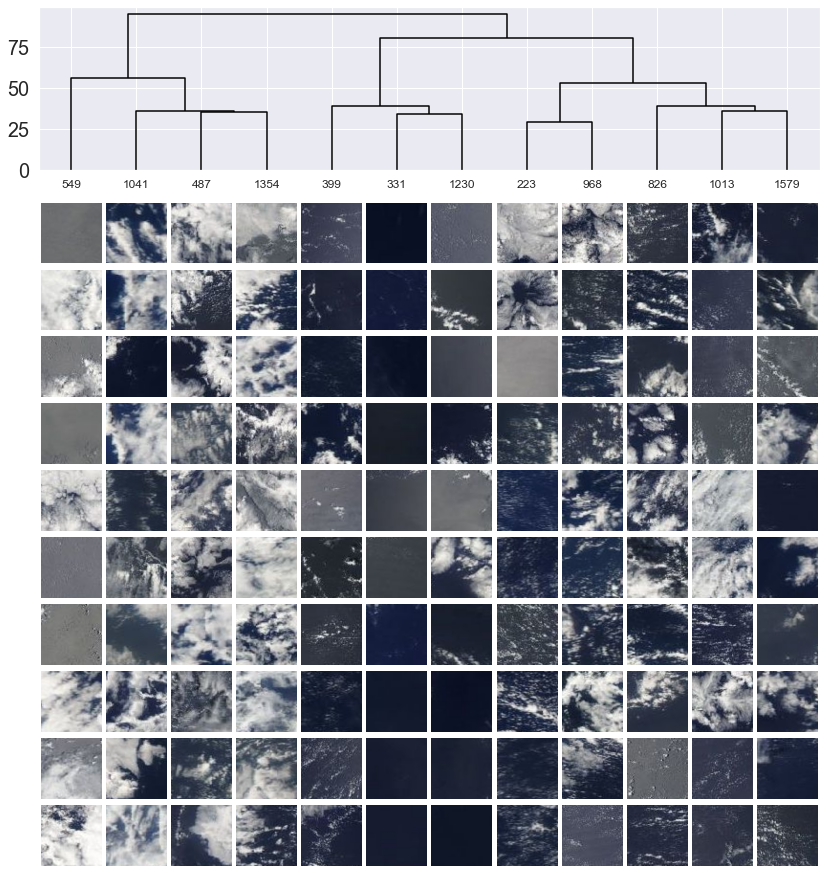

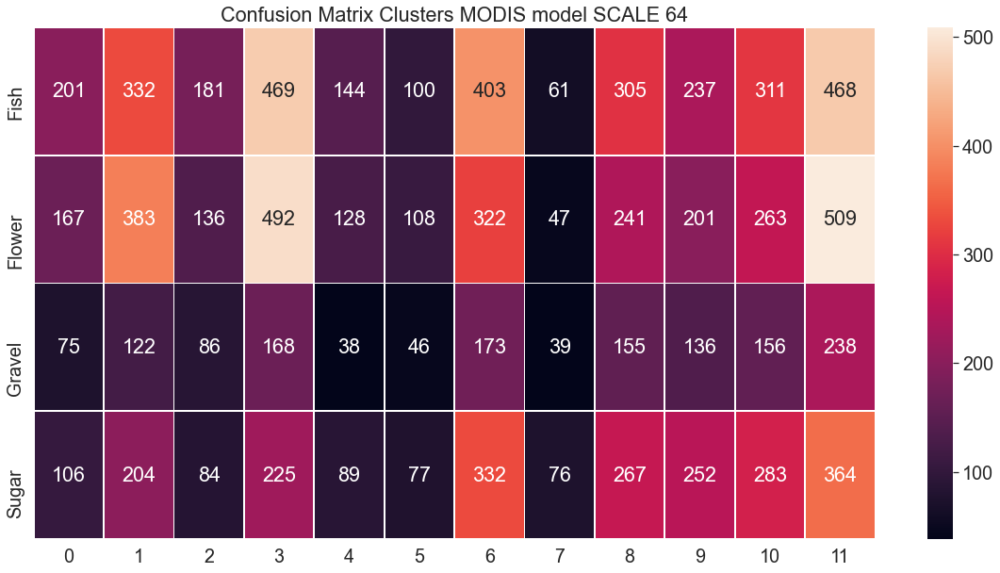

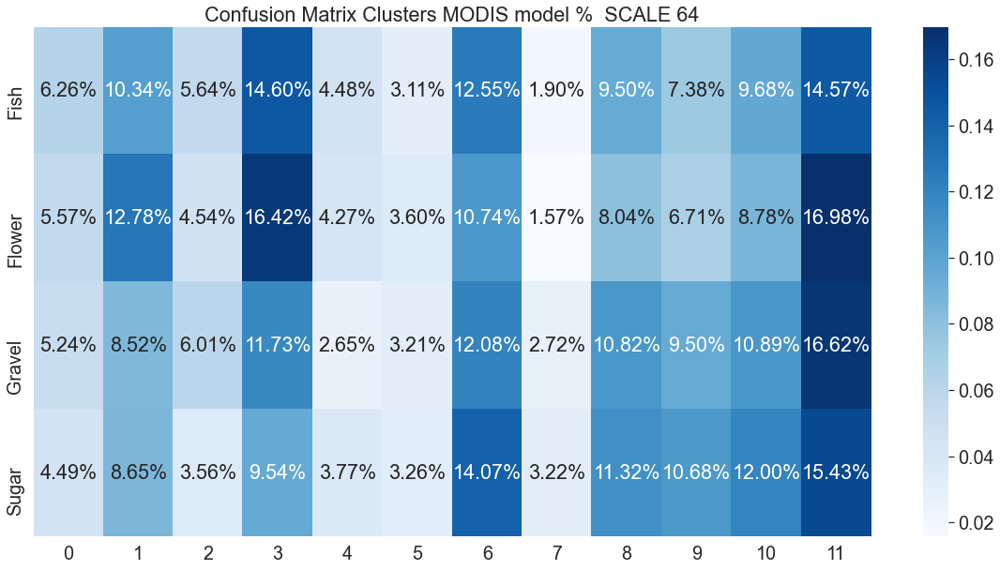

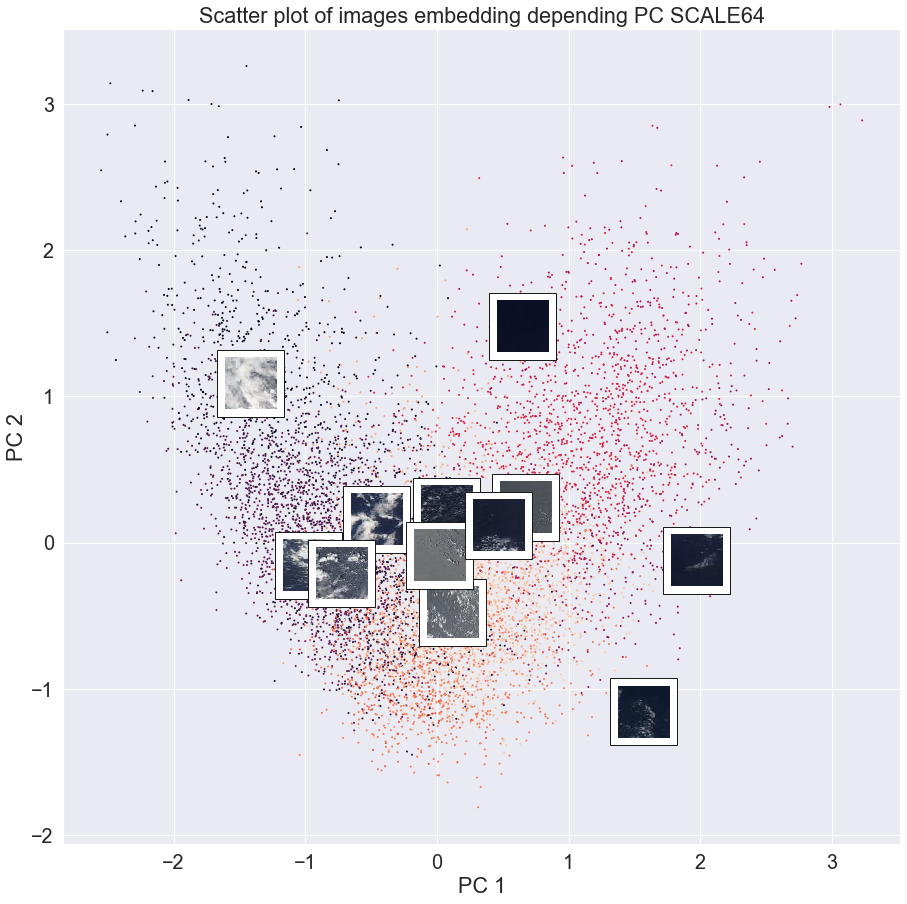

(100,)
[ 1.3982120e-01  7.9594702e-02 -2.0499390e-01 -4.8508760e-01
 -5.3678840e-01 -2.0515509e-01 -9.9721730e-01 -1.2167535e+00
  9.0958633e-02  1.3566151e+00 -1.1509579e-01  6.5390384e-01
  1.6870084e+00 -4.1012004e-01  1.2171055e+00 -1.1198187e+00
 -6.7412305e-01  6.3791829e-01 -3.5504639e-01 -2.3151249e-01
  5.3723890e-01 -5.1859480e-01  8.9018768e-01  2.7850795e-01
 -5.4100913e-01 -1.3669629e-01  1.9676033e-01 -7.2138679e-01
 -5.9292912e-03 -1.3836727e+00  1.6217291e+00  1.5148388e-01
 -1.4177039e+00 -3.6115125e-01  7.2796613e-01  3.0996048e-01
  1.6636051e+00 -3.4931651e-01  1.2148957e-01  1.7139666e+00
  3.9759058e-01 -8.0637105e-02 -1.4273328e+00  1.1125689e+00
 -1.2014024e+00 -4.9731854e-01  1.9183873e-01 -6.7256969e-01
 -1.7914261e+00 -1.7066829e-01 -1.4759352e+00 -3.0540124e-01
 -1.1886909e+00  4.8171622e-01  3.1041214e-01  7.1371841e-01
  1.0271592e+00  4.3337417e-01  1.3666896e+00 -1.7826995e+00
  1.6415691e+00 -1.0680701e+00  2.1639517e-02 -7.7469409e-01
 -5.8649874e-01 -

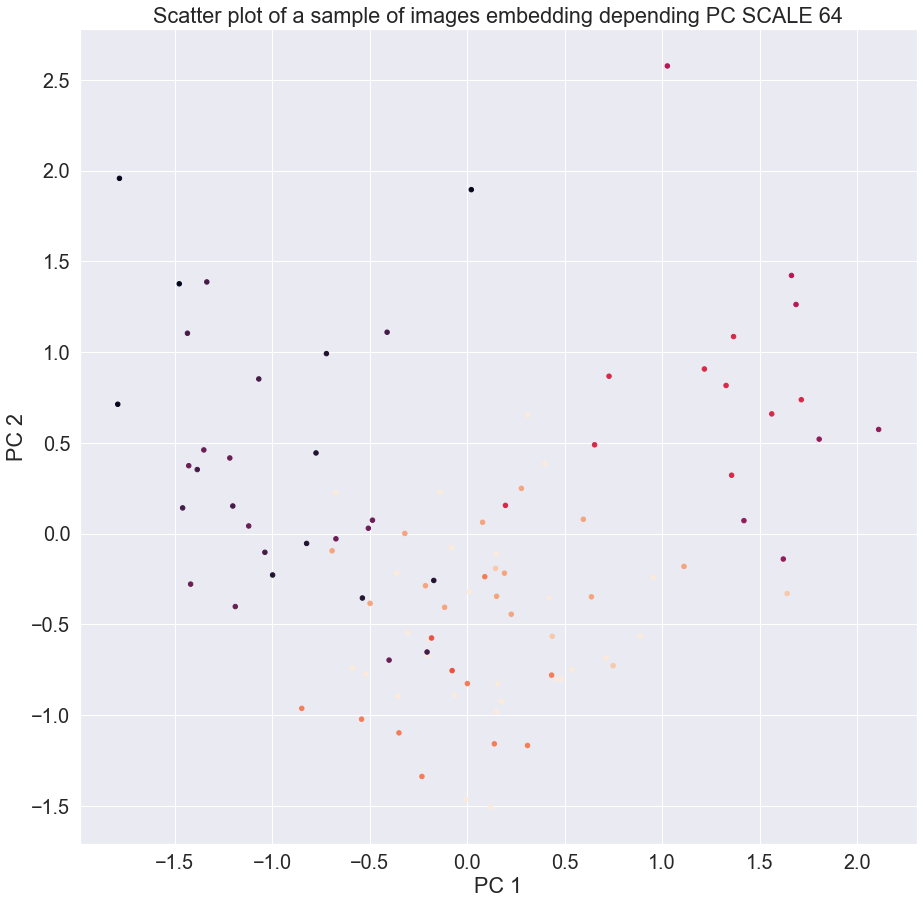

DATASET : ../../../DATASETS/MULTI_SCALE/128/
['labels.pickle', 'train']


100%|████████████████████████████████████████████████████████████████████████████████| 313/313 [10:11<00:00,  1.96s/it]


10000
10000
(4, 12)
(4,)
(12, 4)
10000
10000
128 scale have NMI = 0.024199582352905088
(10000, 2)
(10000,)
[ 1.9414973 -1.096485  -1.3683674 ...  0.997834   1.8471017 -0.4324336]




filename : ../../../DATASETS/MULTI_SCALE/128/train/03332_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/128/train/05018_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/128/train/01127_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/128/train/02452_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/128/train/01114_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/128/train/09043_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/128/train/04575_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/128/train/02656_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/128/train/04226_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/128/train/04581_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/128/train/05522_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/128/train/08731_anchor.png


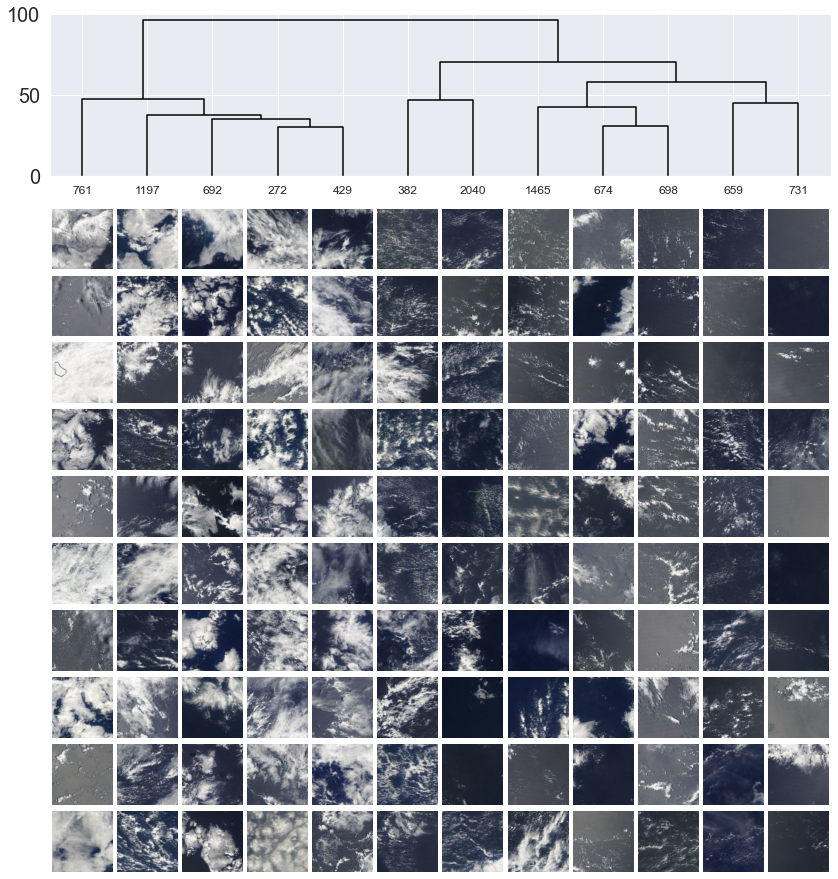

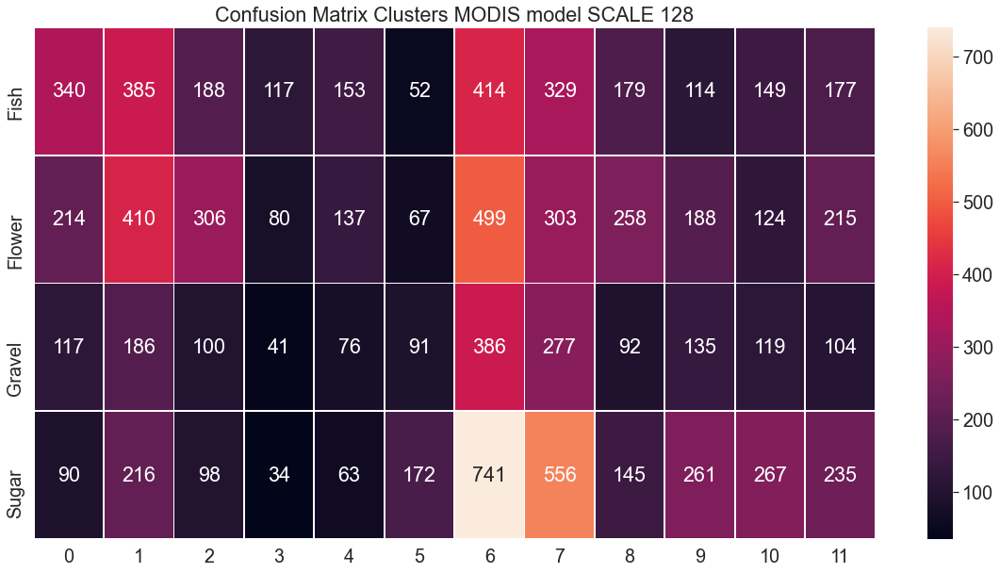

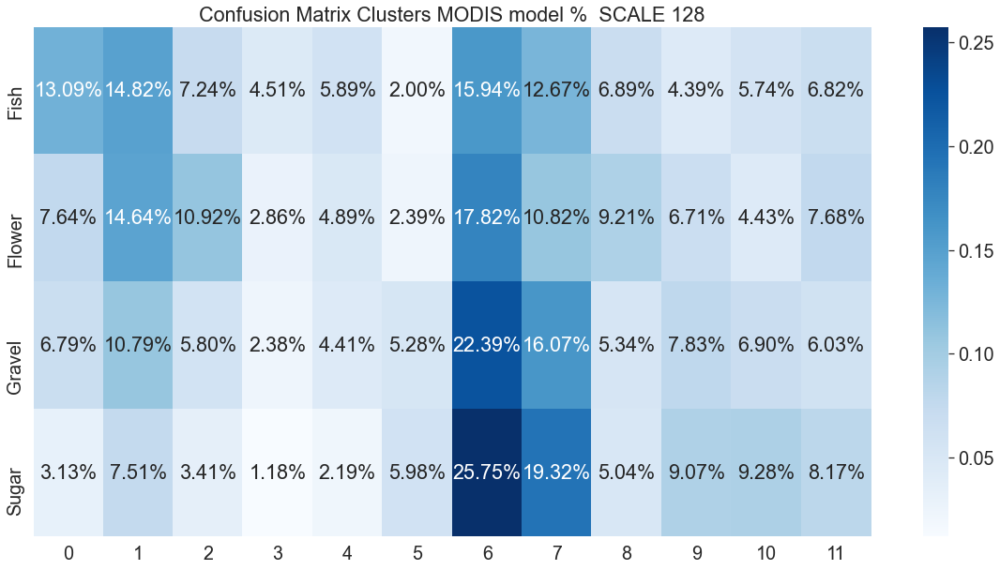

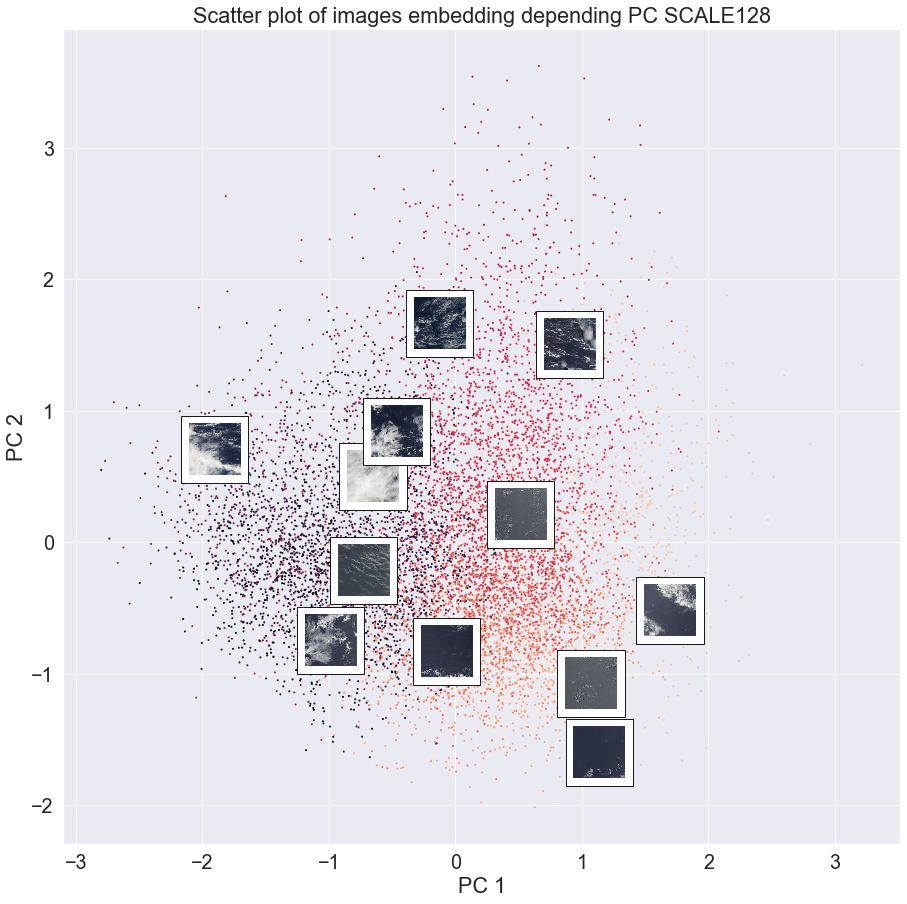

(100,)
[-0.36772025  0.49401212  0.05388658  0.49486488  0.52277756  0.43787718
 -0.34382215  1.0757911   0.7399493   0.06197325 -1.2843972  -1.5310909
  0.9788937   0.40578368 -1.5872835  -0.7733395  -1.6744827   0.26845586
  0.41311717  1.6075201  -0.01435427  0.27942765 -0.36030513 -1.5251408
  0.21667194 -0.35580835  0.48997647  0.36120698 -2.002088   -0.637238
 -0.53541964 -0.54574466 -0.82427716  0.31855986 -0.6748334   1.2001349
 -0.45711753  0.8851774   1.4748305  -1.3513542   1.0955582   0.545682
  0.5812577  -0.47110686  0.23289393 -1.5639768  -0.9638069  -1.6526588
  0.5167923  -0.92505145 -1.2921766   0.4107202   0.38103253 -0.48276356
  0.96972233 -1.3160106  -1.1831491  -0.22777276 -0.3560516   0.6908378
  0.59343314 -0.9584281   0.27549997  0.49077818  0.82832366  0.8546285
 -1.3326337   0.44289014 -1.3895597   0.31991884 -0.02460849  1.7516606
 -1.2057339   0.15233366  0.83240354 -1.7614905   0.17888473  0.9773281
 -1.2000467  -1.2502093  -1.5200325   0.6871872   1.0159

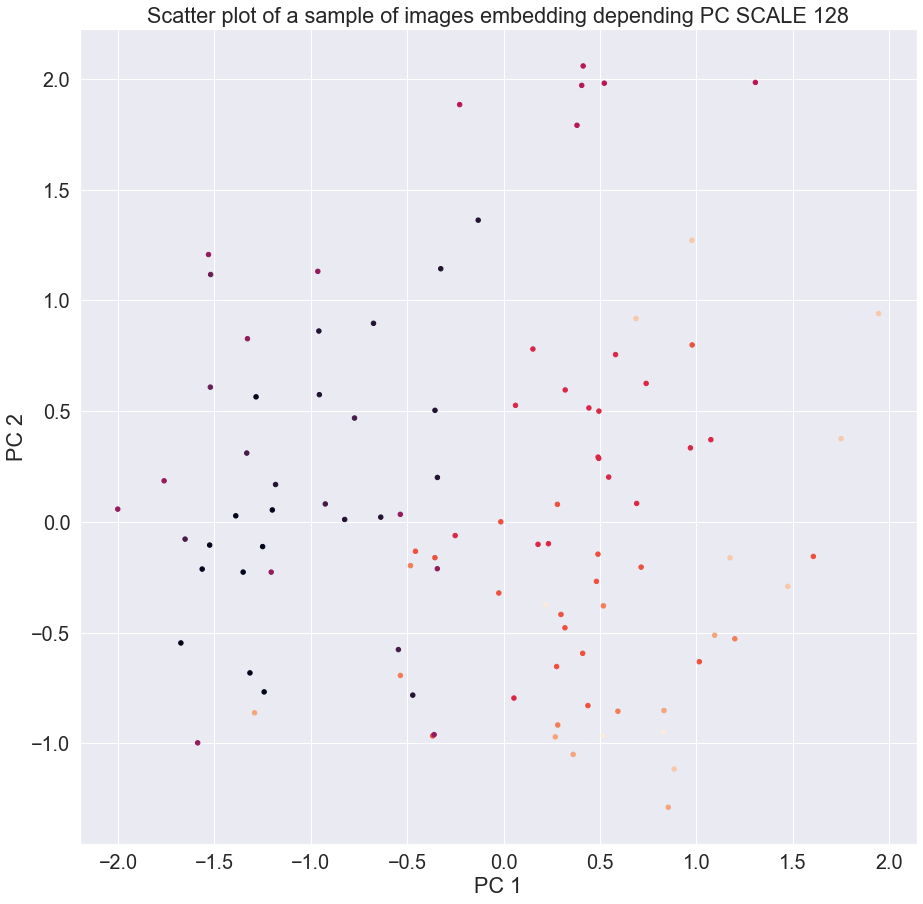

DATASET : ../../../DATASETS/MULTI_SCALE/256/
['labels.pickle', 'train']


100%|████████████████████████████████████████████████████████████████████████████████| 313/313 [10:20<00:00,  1.98s/it]


10000
10000
(4, 12)
(4,)
(12, 4)
10000
10000
256 scale have NMI = 0.0768392537668485
(10000, 2)
(10000,)
[ 1.254654  -1.0198755  0.4396533 ...  1.484876   1.4459233  0.7132368]




filename : ../../../DATASETS/MULTI_SCALE/256/train/01764_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/06999_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/07375_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/05037_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/06484_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/02011_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/08172_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/05038_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/04890_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/06157_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/07085_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/256/train/00823_anchor.png


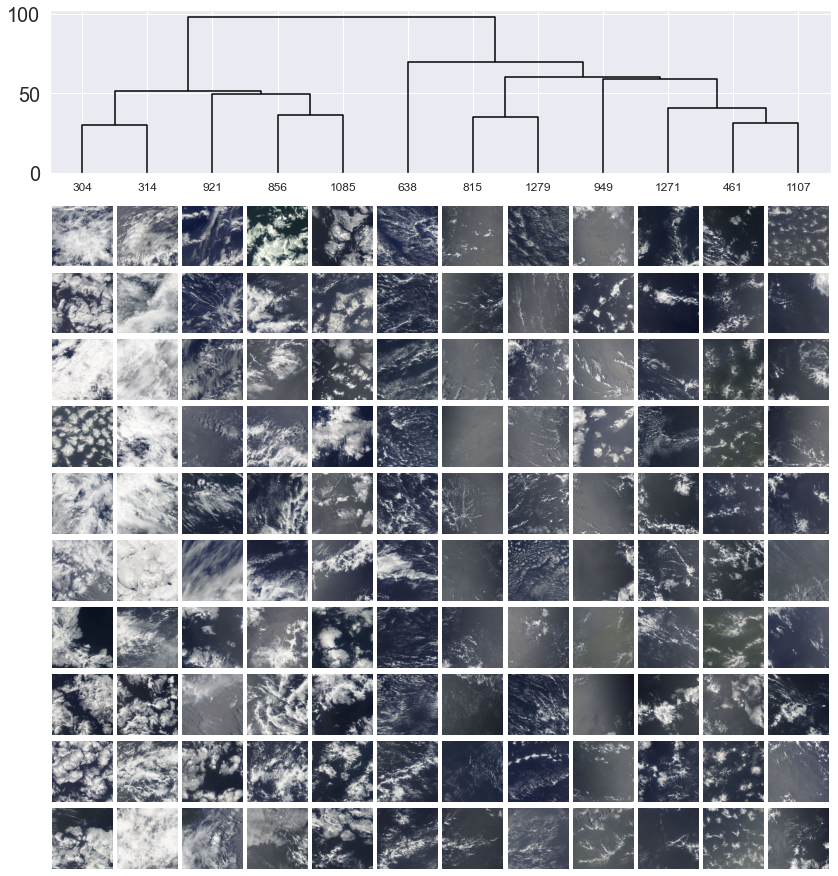

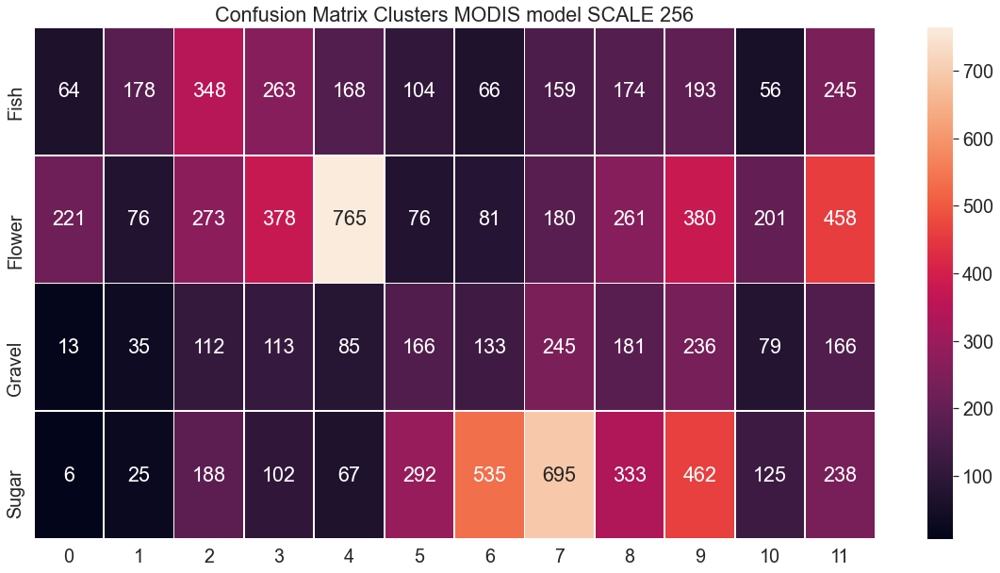

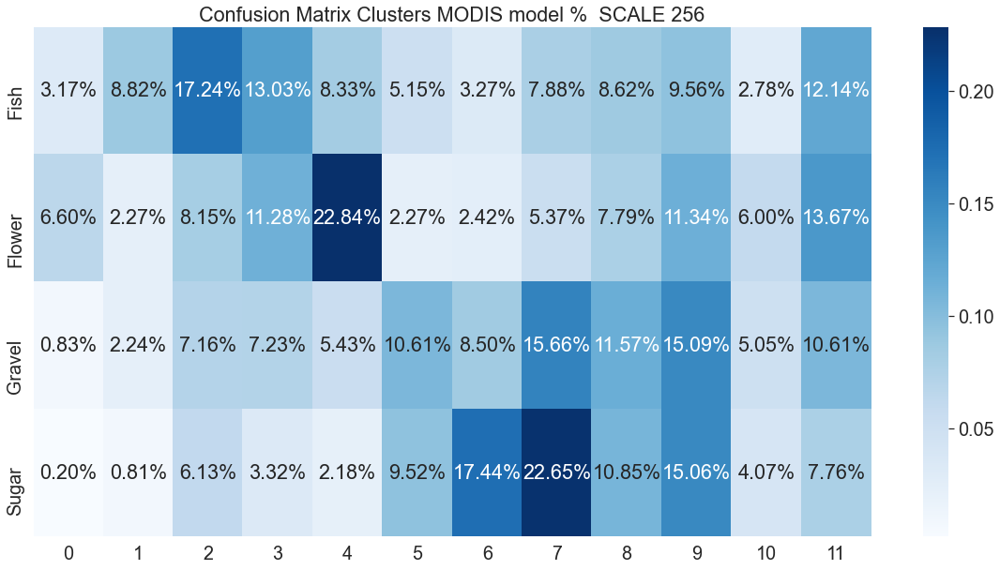

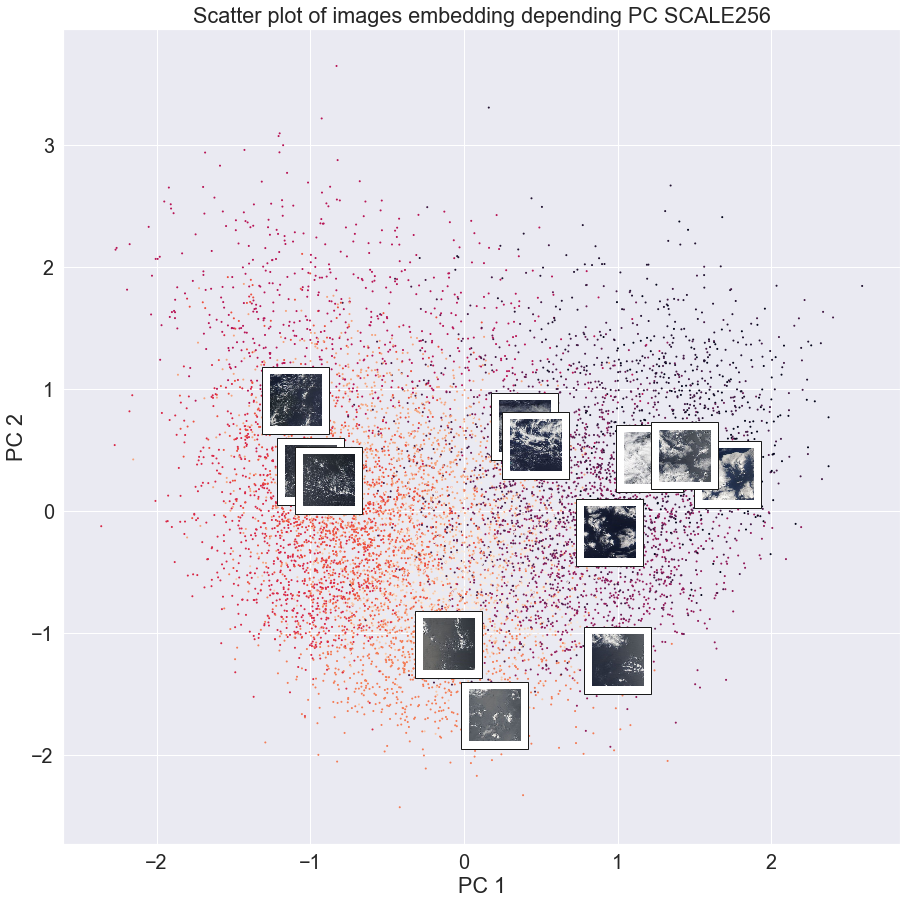

(100,)
[-8.3608425e-01 -1.0979340e+00  1.7063022e+00  6.4435416e-01
 -3.7401897e-01  4.1880888e-01 -6.5896028e-01 -3.2722181e-01
 -4.4414781e-02  5.4011875e-01  1.3049358e+00  1.1461963e-01
 -8.6272992e-02  8.4674621e-01  1.9922390e+00 -1.1408298e+00
 -1.7976257e-01 -8.4720111e-01 -1.5233288e+00 -1.2628720e+00
 -7.7387875e-01 -7.2087008e-01 -1.3617433e+00 -5.0893974e-01
 -3.1059599e-01  7.6564342e-01  4.8153776e-01 -1.0666650e-01
 -7.3524511e-01  6.1375326e-01  5.5154723e-01 -3.0661646e-01
  1.3246897e+00 -5.7571959e-01 -1.8250324e-02  1.3158454e+00
 -1.0818588e+00  7.9147416e-01  1.8912669e-01  9.8571464e-02
 -1.1441282e+00 -1.1789037e+00  5.7884747e-01 -1.0392150e-01
  6.8675607e-01  1.8238404e+00 -7.1719700e-01  5.5863965e-01
  1.9317427e+00  1.1002895e+00  1.2251873e+00 -9.6540622e-02
 -6.8324082e-02  1.0065848e-02  2.9661542e-01  1.3403330e+00
  7.6448959e-01  9.1636285e-02  5.4232156e-01  1.8301644e+00
  8.5496658e-01  2.7395767e-01 -1.2388519e+00 -9.8358101e-01
 -6.5441823e-01 -

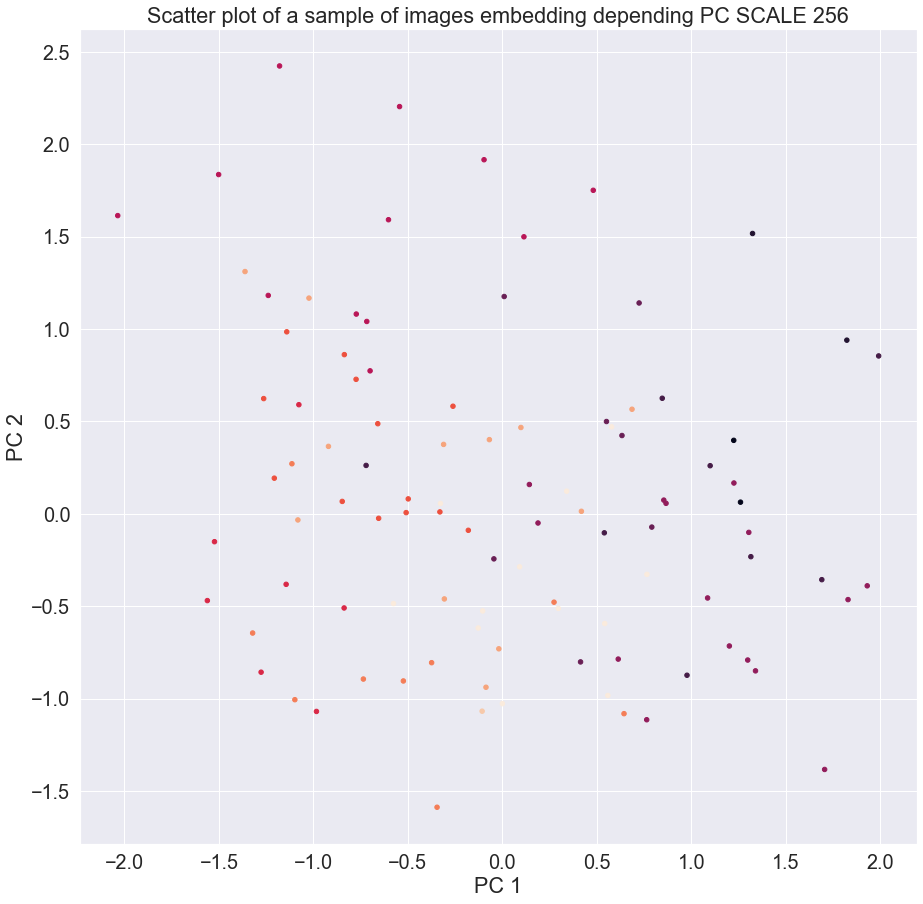

  0%|                                                                                           | 0/37 [00:00<?, ?it/s]

DATASET : ../../../DATASETS/MULTI_SCALE/512/
['labels.pickle', 'train']


100%|██████████████████████████████████████████████████████████████████████████████████| 37/37 [01:12<00:00,  1.97s/it]


1172
1172
(4, 12)
(4,)
(12, 4)
1172
1172
512 scale have NMI = 0.16038507354608583
(1172, 2)
(1172,)
[-0.06671054 -0.5968176  -0.5196395  ...  1.041157    0.08778919
  0.16096927]




filename : ../../../DATASETS/MULTI_SCALE/512/train/00943_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/512/train/00022_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/512/train/00738_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/512/train/00025_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/512/train/00902_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/512/train/00289_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/512/train/00012_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/512/train/01099_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/512/train/00751_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/512/train/00358_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/512/train/00684_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/512/train/01016_anchor.png


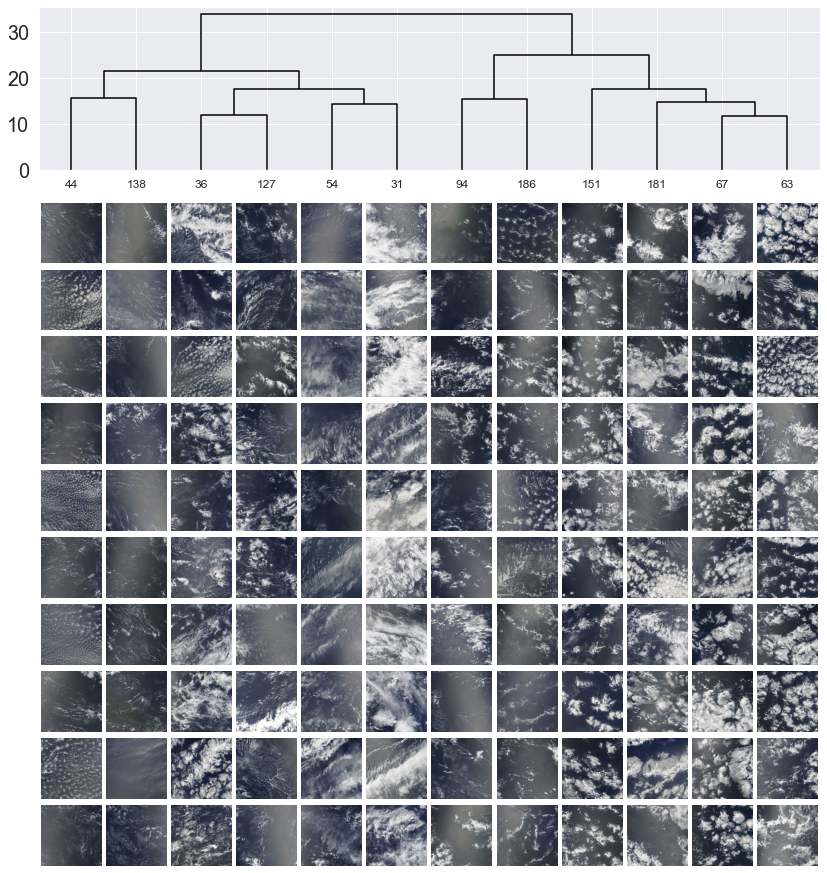

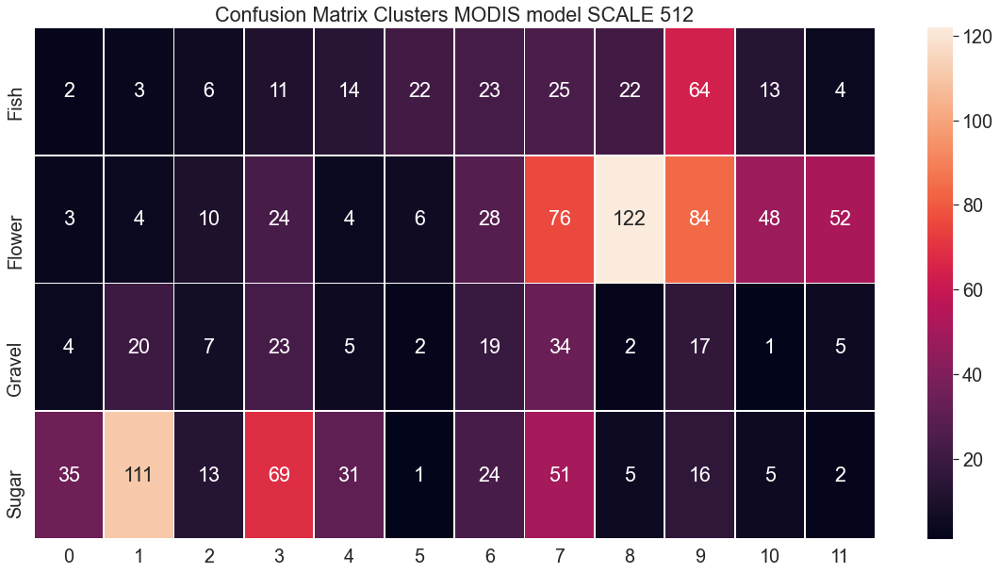

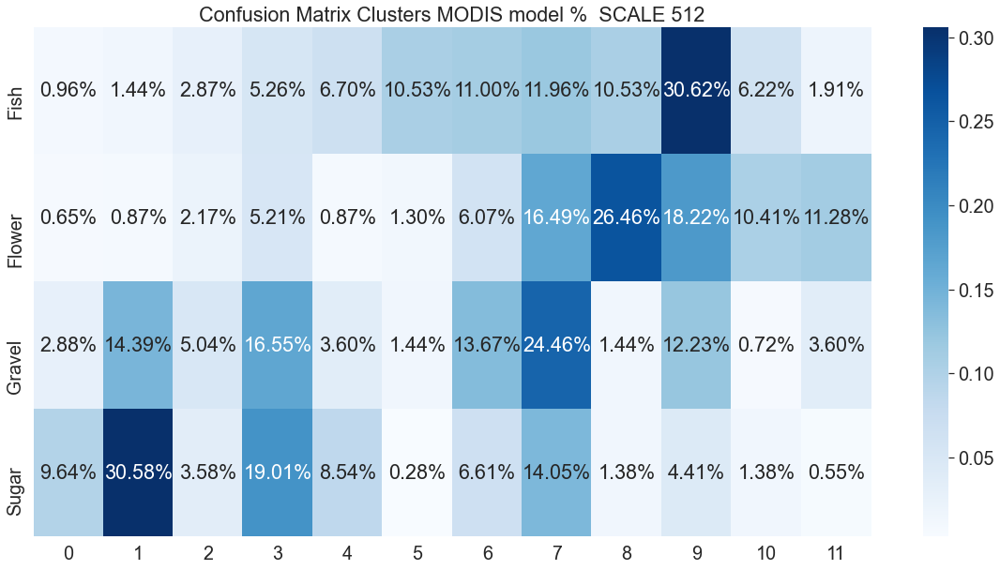

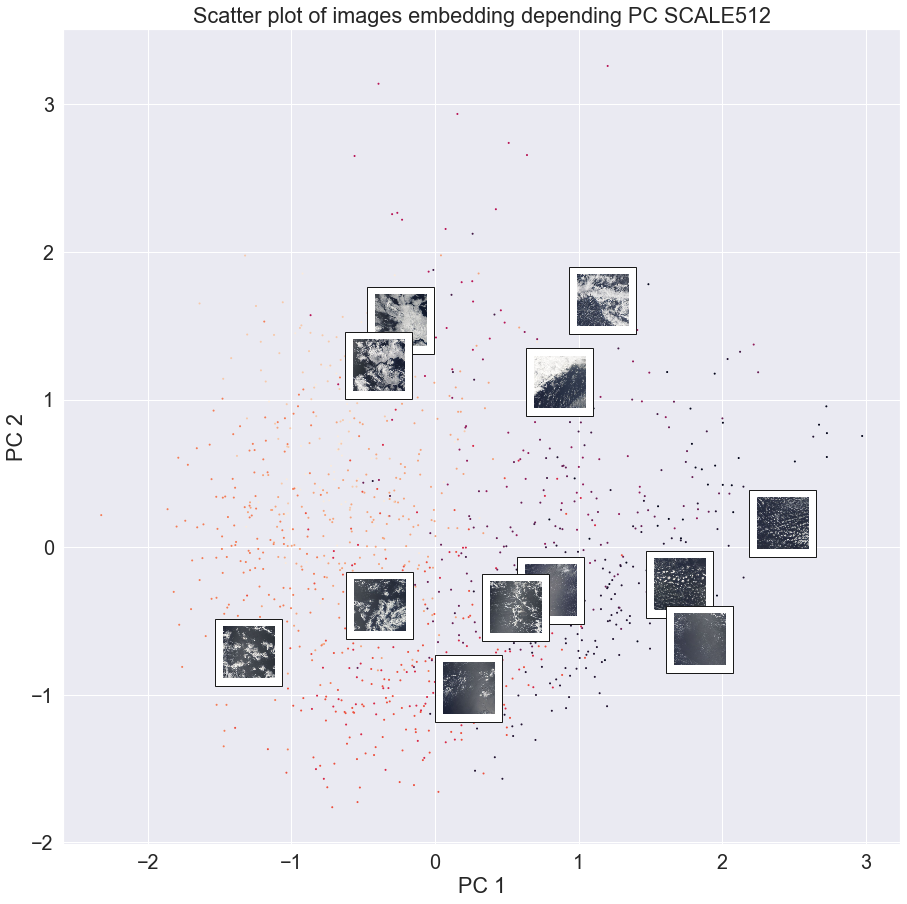

(12,)
[-0.05025212  0.9134845   1.2731056  -0.5335757  -1.229714   -1.5562426
 -0.00436439  1.9475677   0.3118262   1.4730669  -0.5832583   0.7444056 ]






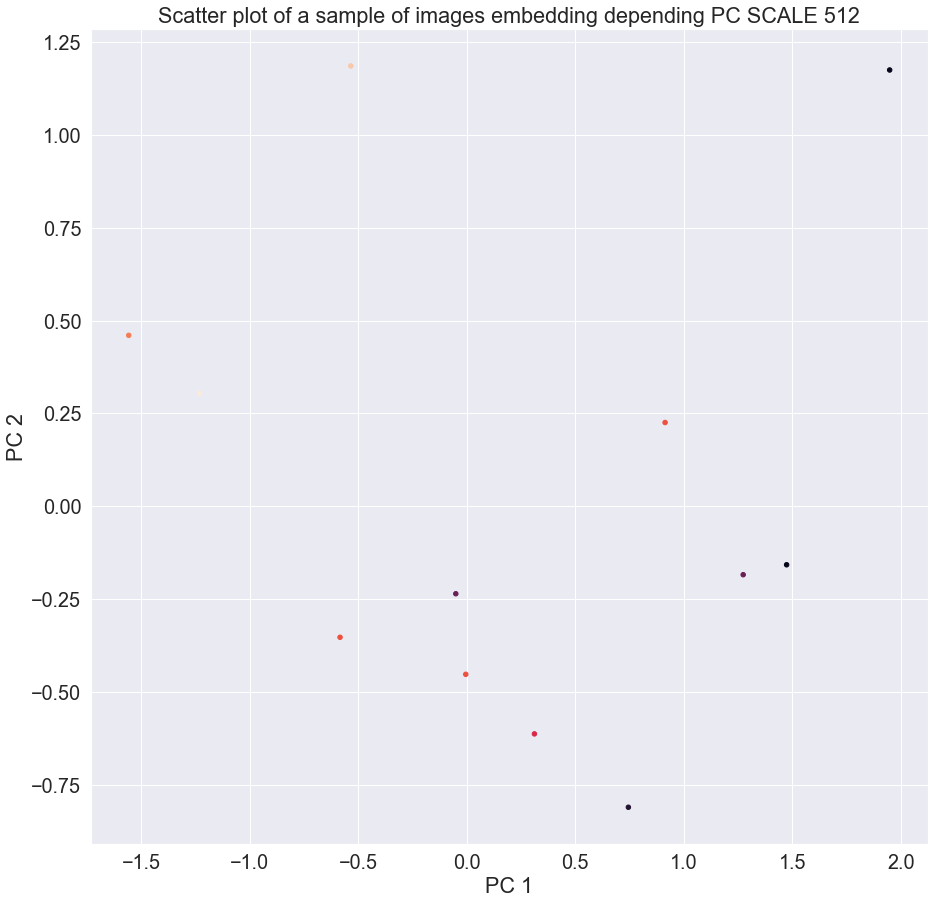

  0%|                                                                                           | 0/14 [00:00<?, ?it/s]

DATASET : ../../../DATASETS/MULTI_SCALE/612/
['labels.pickle', 'train']


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:25<00:00,  1.84s/it]


424
424
(4, 12)
(4,)
(12, 4)
424
424
612 scale have NMI = 0.1671278207930043
(424, 2)
(424,)
[ 0.5299179  -0.3029091  -0.34153318  1.1247491  -0.04754958 -0.586883
  0.5852671  -1.3196558   2.521219   -1.5511942  -1.3944085  -0.11671074
  1.801138   -0.313116   -0.6342405   0.02180482  0.5055934   0.52589214
  1.4978015  -0.6393614  -0.7014729  -0.48367915 -0.826697    0.11368442
 -0.3441768  -0.32710233 -0.8441543  -0.62379575  0.84357965  0.714762
 -0.27399397  0.96504414 -0.66634375 -1.2562108   0.82032835 -0.5397995
 -1.8085624   0.38918883  0.525604   -0.05096081 -0.25569895 -0.4777818
 -0.11943605 -0.01345928 -0.44253194  0.44386494 -1.4980518  -0.54585546
 -0.63839656 -1.0142565   0.91019773  2.198046    0.6417263   1.602466
  1.5940976   1.5552558  -0.44143748 -1.1215336  -1.5849605  -0.35108387
 -0.47304878  0.8915247   0.22494307  0.05424472  0.81745505  1.738019
  0.17806858 -0.11495814 -0.37914446  0.12226454 -0.8455666  -0.06777647
 -0.652348   -1.0794289   0.08984573  1.4

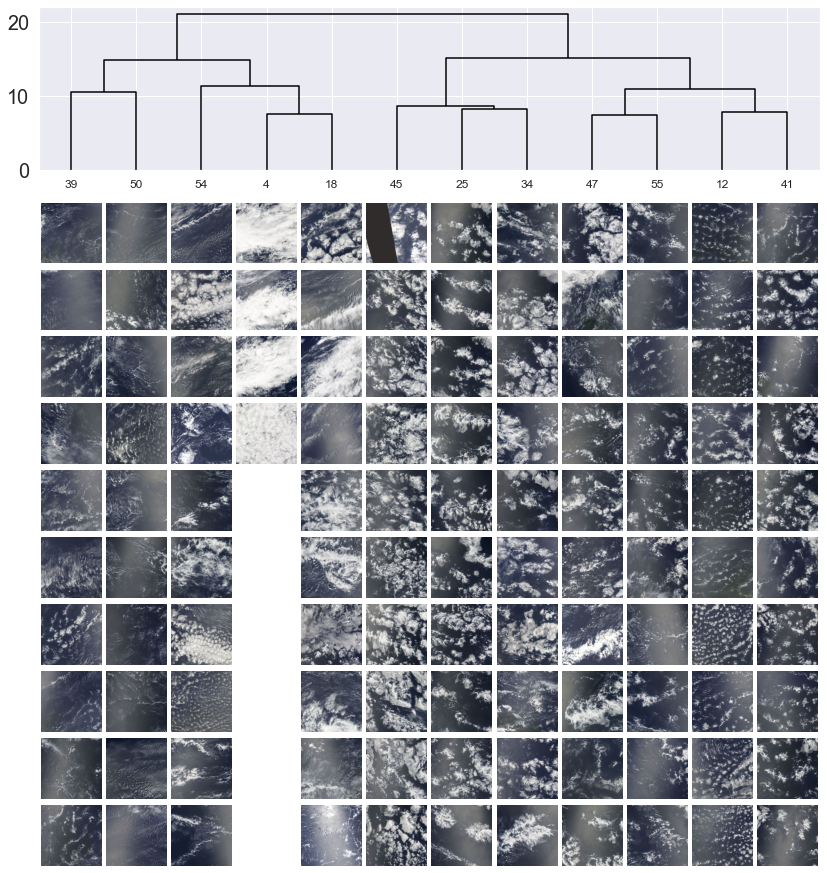

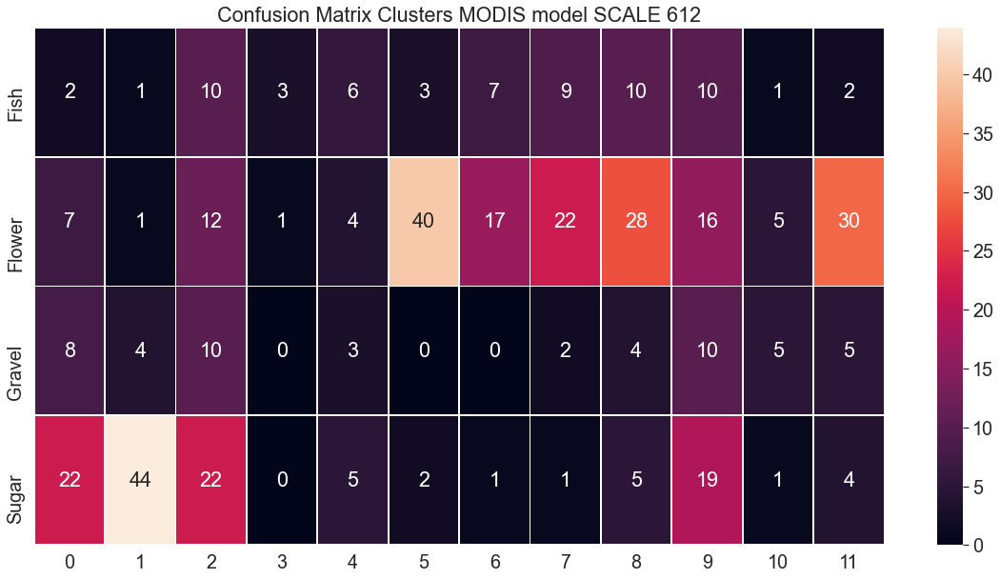

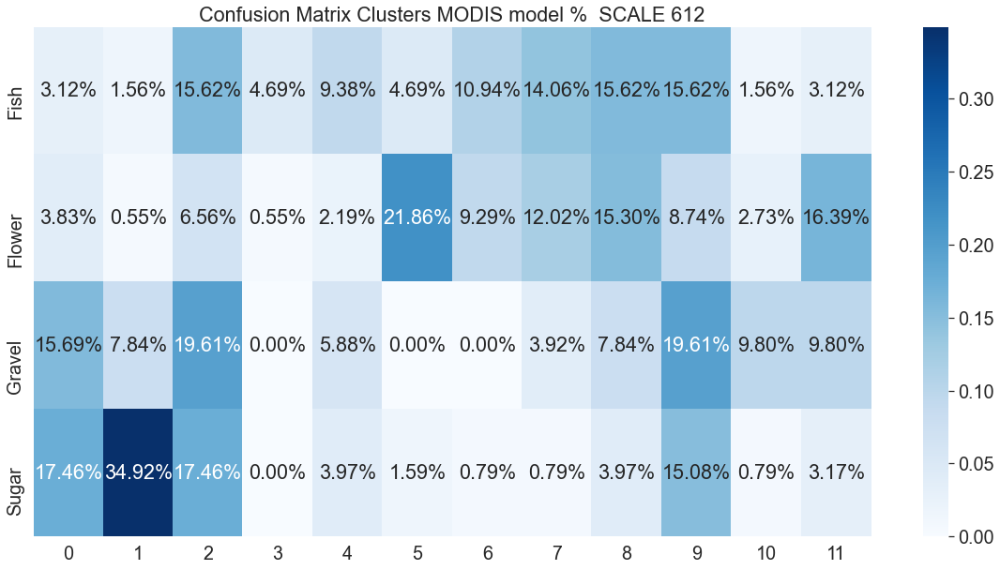

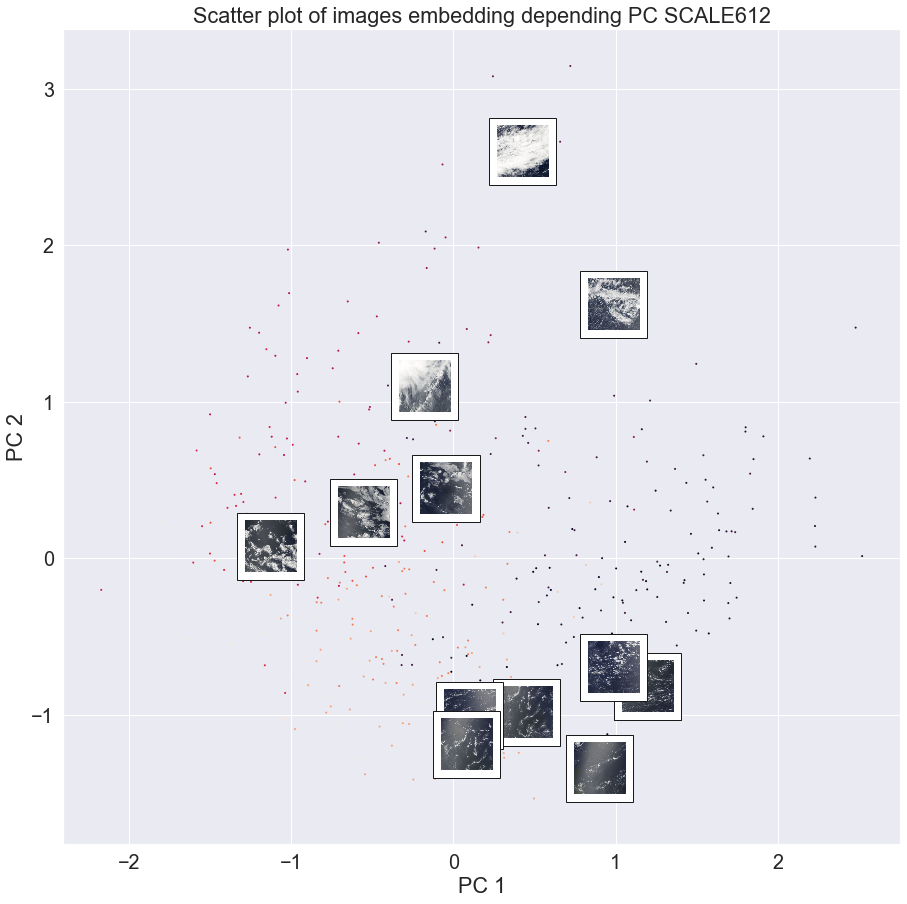

(5,)
[-0.9232619   0.98678696 -1.0941373  -0.67401516 -1.4569633 ]






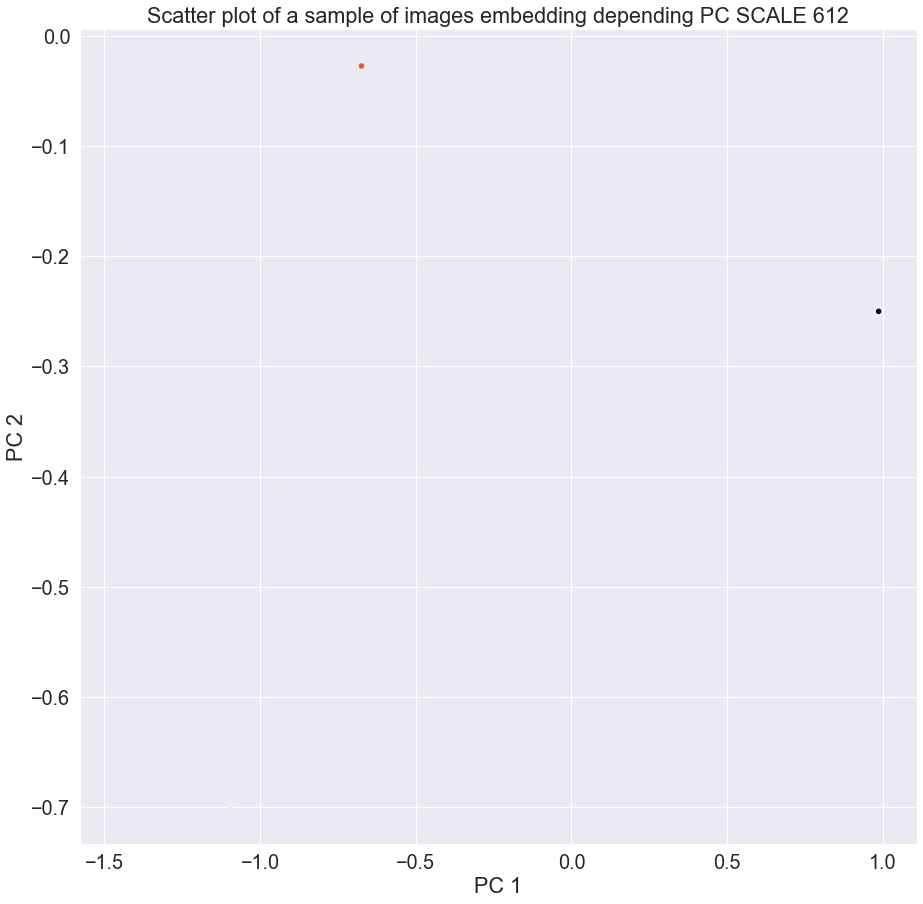

  0%|                                                                                            | 0/1 [00:00<?, ?it/s]

DATASET : ../../../DATASETS/MULTI_SCALE/850/
['labels.pickle', 'train']


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.18s/it]


22
22
(4, 12)
(4,)
(12, 4)
22
22
850 scale have NMI = 0.42465641591369907
(22, 2)
(22,)
[ 0.20174485 -1.8848324   2.0222704  -0.3619517  -0.23051761 -1.2739445
  0.9427773   1.2252325   2.3342626  -0.6502379   0.04861843  0.18189223
  0.5405071   1.1966801  -0.13554916 -0.5102751  -1.0970726  -0.6216202
  0.96081865 -1.1751397  -0.13458945 -1.5790733 ]




filename : ../../../DATASETS/MULTI_SCALE/850/train/00006_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/850/train/00013_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/850/train/00002_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/850/train/00008_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/850/train/00017_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/850/train/00020_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/850/train/00005_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/850/train/00019_anchor.png
filename : ../../../DATASETS/MULTI_SCALE/850/train/00015_anchor.png
filename : ../../../DATASETS/

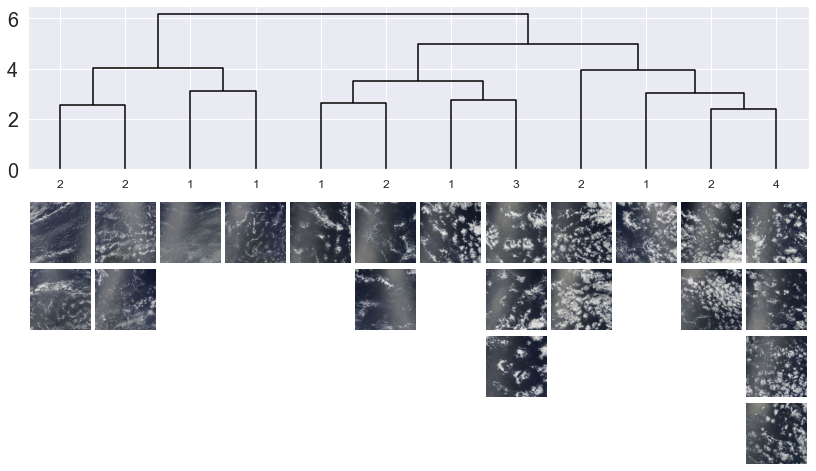

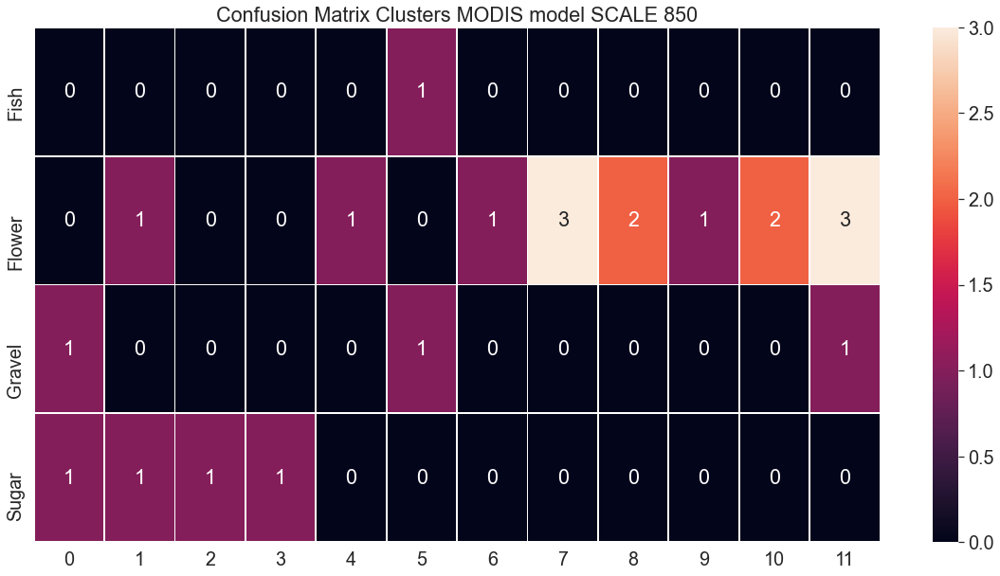

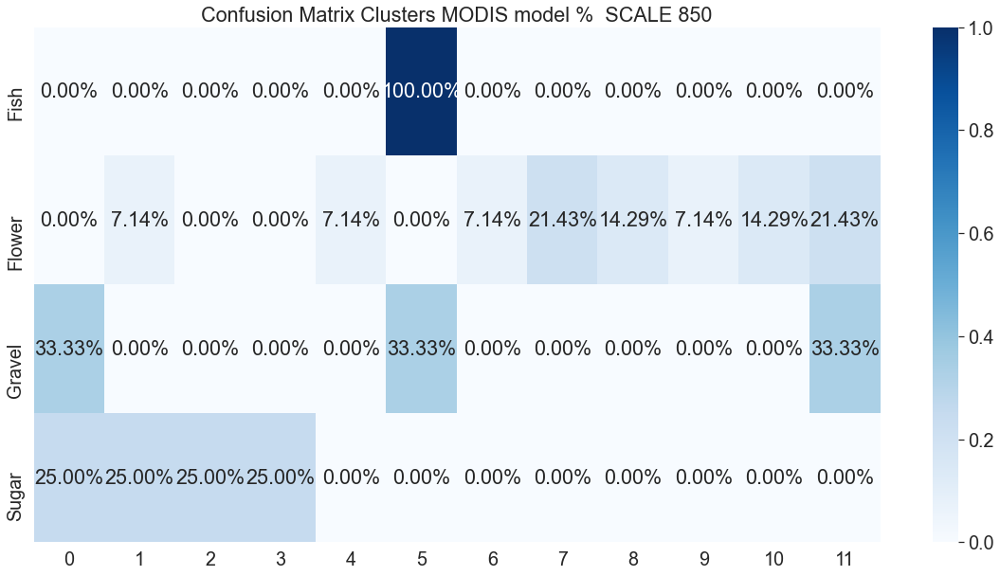

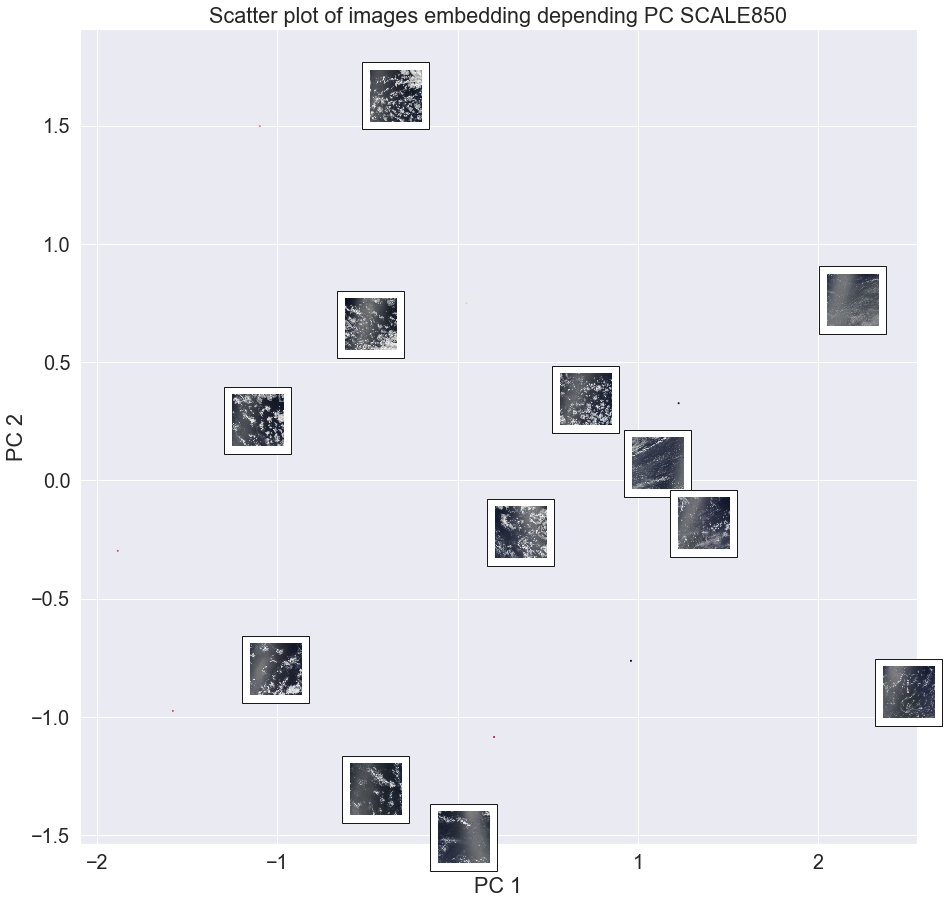

(1,)
[0.20174485]






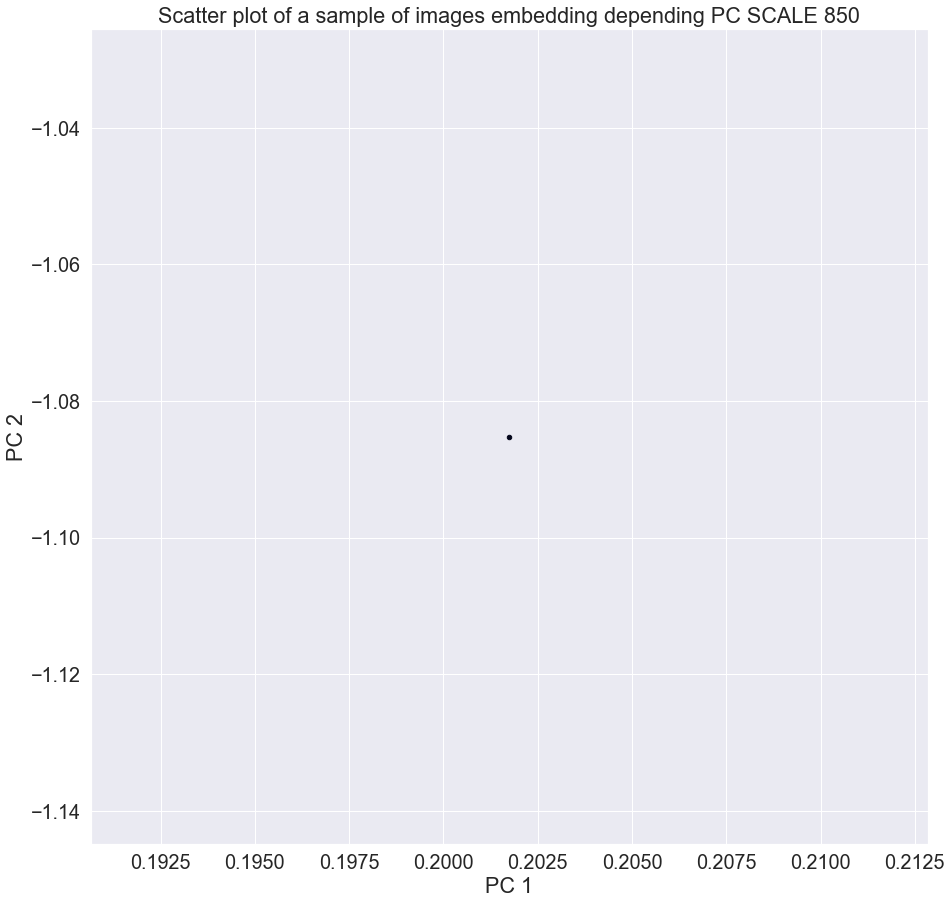

DATASET : ../../../DATASETS/MULTI_SCALE/1024/
['labels.pickle', 'train']


Exception: No train data was found

In [13]:
# ORIGINAL 

import os
divisions = [64, 128, 256, 512, 612, 850, 1024]
for div in divisions:
    dataset_path =  DATASETS_path+'MULTI_SCALE/'+str(div)+'/'
    print("DATASET : "+str(dataset_path))
    print(os.listdir(dataset_path))
    tile_dataset = ImageSingletDataset(data_dir=dataset_path, tile_type=TileType.ANCHOR)
    da_embeddings = get_embeddings(tile_dataset=tile_dataset, model=model)
    clusters = convml_tt.interpretation.plots.dendrogram(da_embeddings, n_samples=10, n_clusters_max=12, return_clusters=True)#, label_clusters=True)
    with open(DATASETS_path+"MULTI_SCALE/"+str(div)+"/labels.pickle", "rb") as handle:
        labs = pickle.load(handle)
    
    print(len(labs))
    print(len(clusters[1]))
    clclc = list(map(int, clusters[1]))
    cfs_mat = confusion_matrix(labs, clclc)

    associations = ['Fish', 'Flower', 'Gravel', 'Sugar']
    fig, ax = plt.subplots(figsize=(20,10)) 
    plt.title("Confusion Matrix Clusters MODIS model SCALE "+str(div))
    sns.set(font_scale=1.8)
    sns.heatmap(cfs_mat[:4,:], annot=True, fmt='', ax=ax, linewidths=.9, yticklabels=associations)
    fig, ax = plt.subplots(figsize=(20,10))
    print(cfs_mat[:4,:].shape)
    print(   np.sum(  cfs_mat[:4,:], axis=1  ).shape  )
    print(   (  cfs_mat[:4,:].T/np.sum(cfs_mat[:4,:], axis=1)    ).shape  )
    plt.title("Confusion Matrix Clusters MODIS model %  SCALE "+str(div))
    sns.heatmap( (cfs_mat[:4,:].T/np.sum(cfs_mat[:4,:], axis=1)).T, annot=True, 
                fmt='.2%', cmap='Blues' , yticklabels=associations)
    print(len(da_embeddings))
    print(len(clusters[1]))
    nmi = normalized_mutual_info_score(labs, clusters[1])
    print(str(div)+" scale have NMI = "+str(nmi))
    nmis[str(div)] = nmi
    pca_2d = PCA(n_components=2, svd_solver='arpack')
    principalComponents = pca_2d.fit_transform(da_embeddings)
    print(principalComponents.shape)
    print(principalComponents[:, 0].shape)
    print(principalComponents[:, 0])
    print("\n\n\n")
    from sklearn.model_selection import train_test_split
    X_train, X_test, y_train, y_test = train_test_split( principalComponents, clusters[1], test_size=0.01, random_state=42)

    fig, ax = plt.subplots(figsize=(15,15))

    ax.scatter(principalComponents[:, 0], principalComponents[:, 1], c=clusters[1], s=1)
    plt.title('Scatter plot of images embedding depending PC SCALE'+str(div))
    ax.set_xlabel('PC 1')
    ax.set_ylabel('PC 2')
    
    for cluster_number in range(0, 12):
        indices = np.where(clusters[1]==cluster_number)[0]
        idx = np.random.choice(indices)
        tm = TILE_FILENAME_FORMAT.format(triplet_id=idx,tile_type='anchor')
        filename = DATASETS_path+"MULTI_SCALE/"+str(div)+"/train/"+tm
        print("filename : "+str(filename))
        arr_img = plt.imread(filename, format='png')    
        imagebox = OffsetImage(arr_img, zoom=0.2)
        xy = (principalComponents[idx, 0], principalComponents[idx, 1])
        
        ab = AnnotationBbox(imagebox, xy,
            xybox=(30, -30),
            xycoords='data',
            boxcoords="offset points")
        ax.add_artist(ab)


    plt.show()

    print(X_test[:, 0].shape)
    print(X_test[:, 0])
    print("\n\n\n")
    fig, ax = plt.subplots(figsize=(15,15))
    ax.scatter(X_test[:, 0], X_test[:, 1], c=y_test, s=20)
    plt.title('Scatter plot of a sample of images embedding depending PC SCALE '+str(div))
    ax.set_xlabel('PC 1')
    ax.set_ylabel('PC 2')
    plt.show()

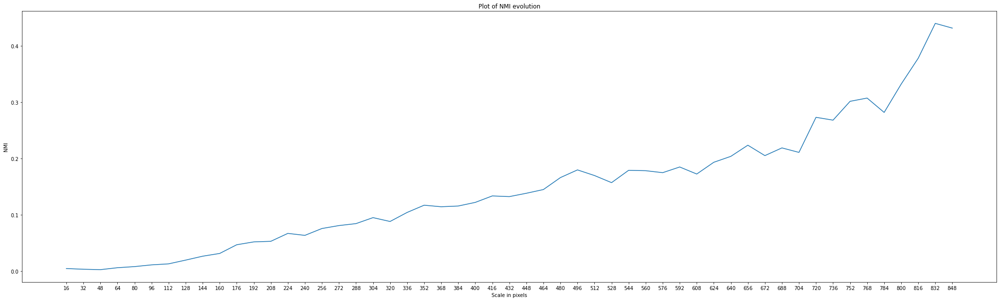

In [19]:
import json
import matplotlib.pyplot as plt
# Opening JSON file
f = open('normalized_mutual_info_scores.json', 'r')
  
nmis = json.load(f)
        
x = list(reversed(list(nmis.keys())))
y = list(reversed(list(nmis.values())))
plt.figure(figsize=(35,10))

plt.plot(x, y)
plt.title('Plot of NMI evolution')
plt.ylabel('NMI')
plt.xlabel('Scale in pixels')
plt.show()